In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import norm
import copy
import sys
import scipy.sparse
import QuantLib as ql
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from scipy.optimize import differential_evolution


sys.executable

'/opt/homebrew/Cellar/jupyterlab/3.4.8/libexec/bin/python3.10'

# Direct solution with Black-Scholes formula

Solving with the formula:

\begin{equation}
C = S_0 N(d_1) - Ke^{-rT} N(d_2)
\end{equation}

In [3]:
def black_scholes_call_price(S, K, T, r, sigma):
    d1 = (np.log(S / K) + np.array((r + 0.5 * sigma ** 2) * T)) / (sigma * np.sqrt(T))
    d2 = d1 - sigma * np.sqrt(T)

    return S * norm.cdf(d1) - K * np.exp(-r * T) * norm.cdf(d2)


def direct_solution(K, r, sigma, T, S_max, S_min, N, M):

    # Mesh
    T_grid = np.linspace(start=T/N, stop=T, num=N)
    S_grid = np.linspace(start=S_min, stop=S_max, num=M)
    S_mesh, T_mesh = np.meshgrid(S_grid, T_grid)
    
    call_prices_base = black_scholes_call_price(S_mesh, K, T_mesh, r, sigma)
    
    return S_mesh, T_mesh, call_prices_base

In [4]:
def build(S_mesh, T_mesh, z_axis_values, name='tmp', zlabel='Call Option Price', xlabel='Underlying price'):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(S_mesh, T_mesh, z_axis_values, cmap='viridis')
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Time to Expiration (years)')
    ax.set_zlabel(zlabel)

    # Change the rotation
    elevation_angle = 30  # in degrees
    azimuth_angle = -135  # in degrees
    ax.view_init(elevation_angle, azimuth_angle)
    plt.savefig(f'/Users/mark/Desktop/hse/course_work/success/pngs/{name}.png')

    plt.show()

# Experiments

In [5]:
# Parameters for SABR implementation

K = 50  # Strike price
r = 0.02  # Risk-free interest rate
sigma = 0.34  # Volatility
T = 1 # Time in years to experience

S_max = 100 # max price
S_min = 1 # min price

N = 364 # Number of time steps
M = 99  # Number of price steps

alpha = 1.63 # Initial volatility value
beta = 0.6 # Skewness parameter
rho = -0.09 # Correlation between price movement and volatility
nu = 1.3 # volatility of volatility

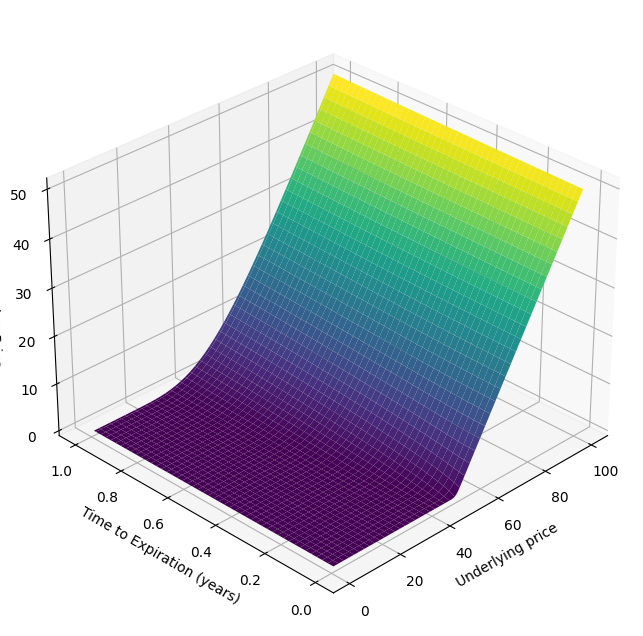

In [6]:
S_mesh, T_mesh, direct_prices = direct_solution(K, r, sigma, T, S_max, S_min, N, M)

build(S_mesh, T_mesh, direct_prices, 'direct', 'Call Option Price')

# SABR Volatility Predictions

In [7]:
def sabr_volatility(strike, forward, expiryTime, alpha, beta, nu, rho):
    oneMinusBeta = 1.0 - beta
    A = np.power(forward * strike, oneMinusBeta)
    sqrtA = np.sqrt(A)
    
    if forward != strike:
        logM = np.log(forward / strike)
    else:
        epsilon = (forward - strike) / strike
        logM = epsilon - 0.5 * epsilon * epsilon
    
    z = (nu / alpha) * sqrtA * logM
    B = 1.0 - 2.0 * rho * z + z * z
    C = oneMinusBeta * oneMinusBeta * logM * logM
    tmp = (np.sqrt(B) + z - rho) / (1.0 - rho)
    xx = np.log(tmp)
    
    D = sqrtA * (1.0 + C / 24.0 + C * C / 1920.0)
    
    d = 1.0 + expiryTime * (oneMinusBeta * oneMinusBeta * alpha * alpha / (24.0 * A) +
                            0.25 * rho * beta * nu * alpha / sqrtA +
                            (2.0 - 3.0 * rho * rho) * (nu * nu / 24.0))
    
    m = 10
    if abs(z * z) > 1e-16 * m:
        multiplier = z / xx
    else:
        multiplier = 1.0 - 0.5 * rho * z - (3.0 * rho * rho - 2.0) * z * z / 12.0
    
    return (alpha / D) * multiplier * d



def volatility_surface(K, T, S_max, S_min, N, M, alpha, beta, rho, nu):
    
    S_grid = np.linspace(S_min, S_max, M)
    T_grid = np.linspace(0, T, N)
    dS = S_grid[1] - S_grid[0]
    dT = T_grid[1] - T_grid[0]

    implied_volatility = np.zeros((N, M))
    for time_index in range(N):
        for price_index in range(M):
            strike = K
            spot = S_grid[price_index]
            time_to_maturity = T_grid[time_index]
            
            implied_volatility[time_index][price_index] = sabr_volatility(strike, spot, time_to_maturity, alpha, beta, nu, rho)

    S_mesh, T_mesh = np.meshgrid(S_grid, T_grid)
    
    return S_mesh, T_mesh, implied_volatility

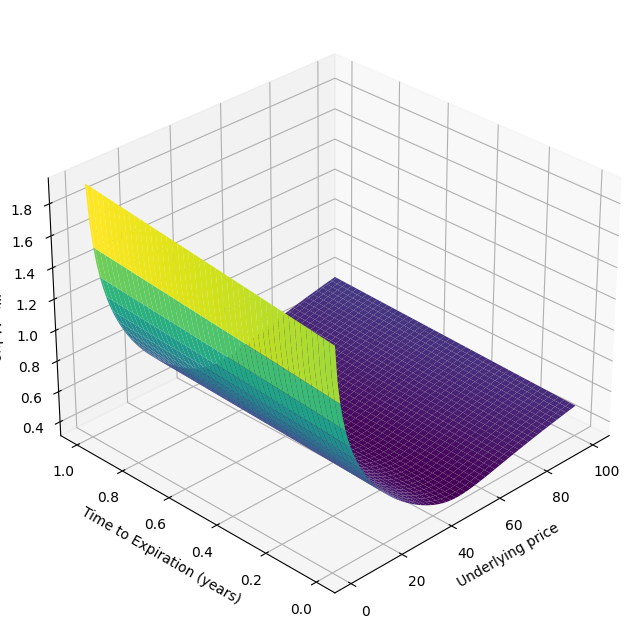

In [8]:
S_mesh, T_mesh, implied_volatility = volatility_surface(K, T, S_max, S_min, N, M, alpha, beta, rho, nu)

build(S_mesh, T_mesh, implied_volatility, 'volatility_surface', 'Volatility Value')

# Black-Scholes with SABR Volatility

In [9]:
def black_scholes_sabr_value(K, r, T, S, alpha, beta, rho, nu):
    vol = sabr_volatility(K, S, T, alpha, beta, nu, rho)
    return black_scholes_call_price(S, K, T, r, vol)
    

def black_scholes_sabr(K, r, T, S_max, S_min, N, M, alpha, beta, rho, nu):
    # Mesh
    T_grid = np.linspace(start=T/N, stop=T, num=N)
    S_grid = np.linspace(start=S_min, stop=S_max, num=M)
    
    implied_volatility = np.zeros((N, M))
    S_mesh, T_mesh, implied_volatility = volatility_surface(K, T, S_max, S_min, N, M, alpha, beta, rho, nu)
    
    call_prices = np.zeros((N, M))
    for time_index in range(N):
        for price_index in range(M):
            strike = K
            spot = S_grid[price_index]
            time_to_maturity = T_grid[time_index]
            
            call_prices[time_index][price_index] = black_scholes_call_price(spot, strike, time_to_maturity, r, implied_volatility[time_index][price_index])
    
    return S_mesh, T_mesh, call_prices

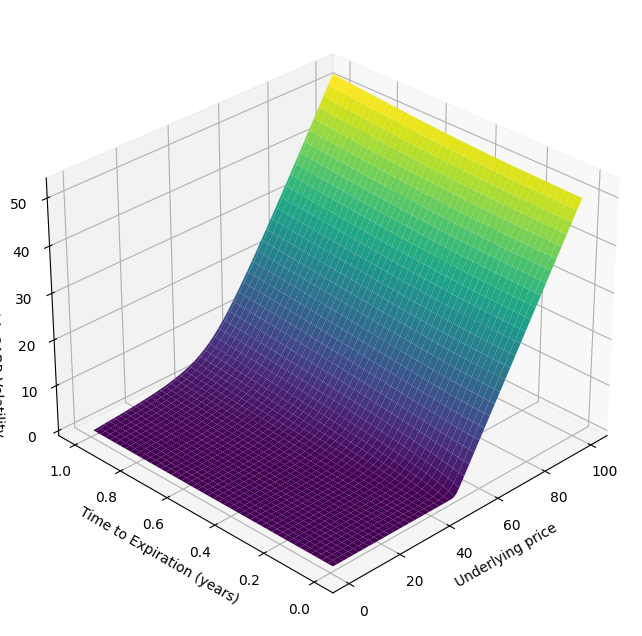

In [10]:
S_mesh, T_mesh, call_prices = black_scholes_sabr(K, r, T, S_max, S_min, N, M, alpha, beta, rho, nu)

build(S_mesh, T_mesh, call_prices, 'bs_with_sabr', 'Call Option Price with SABR Volatility')

# BS vs BS+SABR

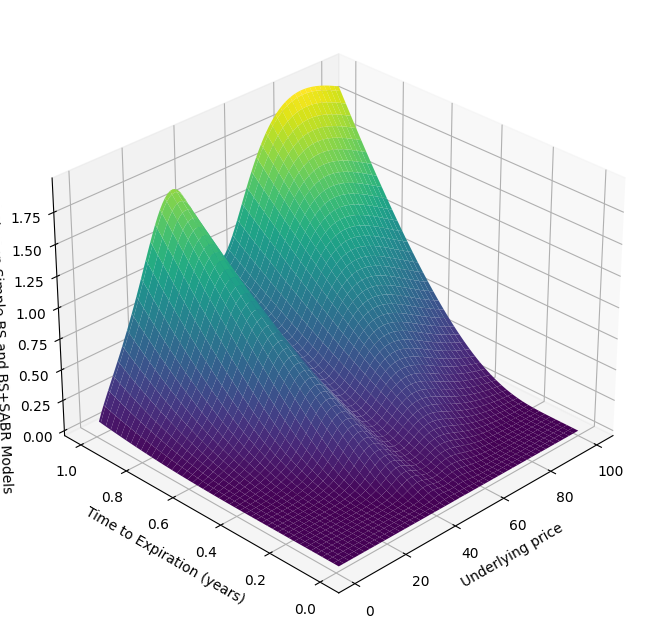

In [11]:
build(S_mesh, T_mesh, call_prices - direct_prices, 'bs_simple_vs_bs_sabr', 'Difference Between Simple BS and BS+SABR Models')

# Marketdata Preparation for Model Calibration

Dataset chosen to work with: [kaggle](https://www.kaggle.com/datasets/tanay001/nseindia-futures-options-daily?resource=download) - marketdata from NSE (Indian largest exchange, times bigger than MOEX). Data is relevant as there are only European options trading.

In [12]:
marketdata = pd.read_csv('fobhav.csv')

/var/folders/64/b16vgw0x37l6j2qnkkq99rlc0000gp/T/ipykernel_19867/2271767734.py:1: DtypeWarning: Columns (3,5,6,7,8,9,10,11,12,13) have mixed types. Specify dtype option on import or set low_memory=False.
  marketdata = pd.read_csv('fobhav.csv')


In [13]:
marketdata.head()

,INSTRUMENT,SYMBOL,EXPIRY_DT,STRIKE_PR,OPTION_TYP,OPEN,HIGH,LOW,CLOSE,SETTLE_PR,CONTRACTS,VAL_INLAKH,OPEN_INT,CHG_IN_OI,TIMESTAMP,Unnamed: 15
0,FUTIDX,BANKNIFTY,24-Sep-2020,0.0,XX,24900.05,25270.0,23371.0,23743.0,23743.0,504222,3051593.27,1432850,-54500,31-AUG-2020,NaN
1,FUTIDX,BANKNIFTY,29-Oct-2020,0.0,XX,24937.55,25315.9,23391.9,23770.1,23770.1,10630,64526.57,91375,19325,31-AUG-2020,NaN
2,FUTIDX,BANKNIFTY,26-Nov-2020,0.0,XX,24989.95,25280.75,23437.15,23766.2,23766.2,1171,7088.68,14400,8400,31-AUG-2020,NaN
3,FUTIDX,NIFTY,24-Sep-2020,0.0,XX,11764.9,11794.45,11350.5,11401.95,11401.95,314090,2722114.47,11209650,-1007775,31-AUG-2020,NaN
4,FUTIDX,NIFTY,29-Oct-2020,0.0,XX,11765.6,11804.3,11368.0,11430.5,11430.5,8666,75149.14,536250,47925,31-AUG-2020,NaN


In [14]:
marketdata

,INSTRUMENT,SYMBOL,EXPIRY_DT,STRIKE_PR,OPTION_TYP,OPEN,HIGH,LOW,CLOSE,SETTLE_PR,CONTRACTS,VAL_INLAKH,OPEN_INT,CHG_IN_OI,TIMESTAMP,Unnamed: 15
0,FUTIDX,BANKNIFTY,24-Sep-2020,0.0,XX,24900.05,25270.0,23371.0,23743.0,23743.0,504222,3051593.27,1432850,-54500,31-AUG-2020,NaN
1,FUTIDX,BANKNIFTY,29-Oct-2020,0.0,XX,24937.55,25315.9,23391.9,23770.1,23770.1,10630,64526.57,91375,19325,31-AUG-2020,NaN
2,FUTIDX,BANKNIFTY,26-Nov-2020,0.0,XX,24989.95,25280.75,23437.15,23766.2,23766.2,1171,7088.68,14400,8400,31-AUG-2020,NaN
3,FUTIDX,NIFTY,24-Sep-2020,0.0,XX,11764.9,11794.45,11350.5,11401.95,11401.95,314090,2722114.47,11209650,-1007775,31-AUG-2020,NaN
4,FUTIDX,NIFTY,29-Oct-2020,0.0,XX,11765.6,11804.3,11368.0,11430.5,11430.5,8666,75149.14,536250,47925,31-AUG-2020,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112070630,FUTIDX,NIFTY,27-Jul-2000,0,XX,1445.0,1445.0,1445.0,1445.0,1445.0,1,2.89,3000,200,13-JUN-2000,NaN
112070631,FUTIDX,NIFTY,31-Aug-2000,0,XX,1445.0,1445.0,1445.0,1445.0,1445.0,1,2.89,600,0,13-JUN-2000,NaN
112070632,FUTIDX,NIFTY,29-Jun-2000,0,XX,1461.0,1472.0,1451.0,1452.75,1451.15,62,181.2,4000,4000,12-JUN-2000,NaN
112070633,FUTIDX,NIFTY,27-Jul-2000,0,XX,1478.0,1478.0,1470.0,1478.0,1470.0,14,41.19,2800,2800,12-JUN-2000,NaN


In [15]:
marketdata.INSTRUMENT.unique()

array(['FUTIDX', 'FUTSTK', 'OPTIDX', 'OPTSTK', 'FUTIVX', '*Updated',
       'FUTINT', 'UNDINT', 'INSTRUMENT'], dtype=object)

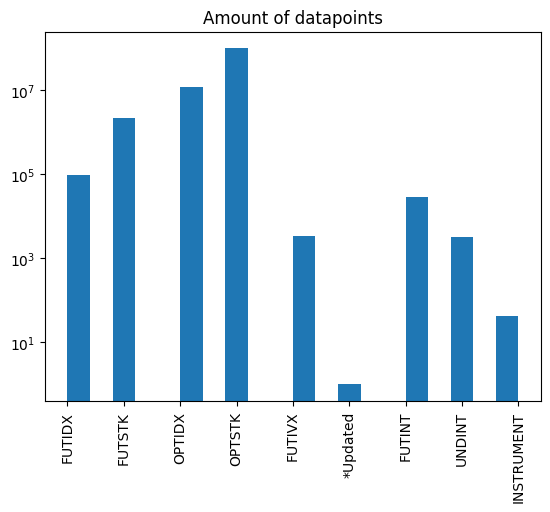

In [16]:
plt.hist(marketdata.INSTRUMENT, bins=20)
plt.yscale('log')
plt.xticks(rotation=90)
plt.title('Amount of datapoints')
plt.show()

In [17]:
small = marketdata[marketdata.INSTRUMENT == 'OPTIDX']

In [18]:
small

,INSTRUMENT,SYMBOL,EXPIRY_DT,STRIKE_PR,OPTION_TYP,OPEN,HIGH,LOW,CLOSE,SETTLE_PR,CONTRACTS,VAL_INLAKH,OPEN_INT,CHG_IN_OI,TIMESTAMP,Unnamed: 15
414,OPTIDX,BANKNIFTY,03-Sep-2020,18100.0,CE,0.0,0.0,0.0,6523.6,5660.65,0,0.0,25,0,31-AUG-2020,NaN
415,OPTIDX,BANKNIFTY,03-Sep-2020,18200.0,CE,0.0,0.0,0.0,3122.85,5560.7,0,0.0,0,0,31-AUG-2020,NaN
416,OPTIDX,BANKNIFTY,03-Sep-2020,18300.0,CE,6236.6,6236.6,5684.5,5684.5,5460.75,2,12.13,50,25,31-AUG-2020,NaN
417,OPTIDX,BANKNIFTY,03-Sep-2020,18400.0,CE,0.0,0.0,0.0,3472.2,5360.8,0,0.0,0,0,31-AUG-2020,NaN
418,OPTIDX,BANKNIFTY,03-Sep-2020,18500.0,CE,0.0,0.0,0.0,3394.4,5260.8,0,0.0,0,0,31-AUG-2020,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112069943,OPTIDX,NIFTY,30-Aug-2001,1100,PE,0.0,0.0,0.0,30.6,38.3,0,0.0,0,0,4-JUN-2001,NaN
112069944,OPTIDX,NIFTY,30-Aug-2001,1120,PE,0.0,0.0,0.0,37.75,46.5,0,0.0,0,0,4-JUN-2001,NaN
112069945,OPTIDX,NIFTY,30-Aug-2001,1140,PE,45.0,45.0,45.0,45.0,45.0,2,4.74,0,0,4-JUN-2001,NaN
112069946,OPTIDX,NIFTY,30-Aug-2001,1160,PE,0.0,0.0,0.0,55.0,66.0,0,0.0,0,0,4-JUN-2001,NaN


In [19]:
small.SYMBOL.unique()

array(['BANKNIFTY', 'NIFTY', 'NIFTYIT', 'NIFTYMID50', 'NIFTYCPSE',
       'NIFTYINFRA', 'NIFTYPSE', 'FTSE100', 'S&P500', 'CNXINFRA', 'CNXIT',
       'CNXPSE', 'NFTYMCAP50', 'MINIFTY', 'CNX100', 'DEFTY', 'JUNIOR'],
      dtype=object)

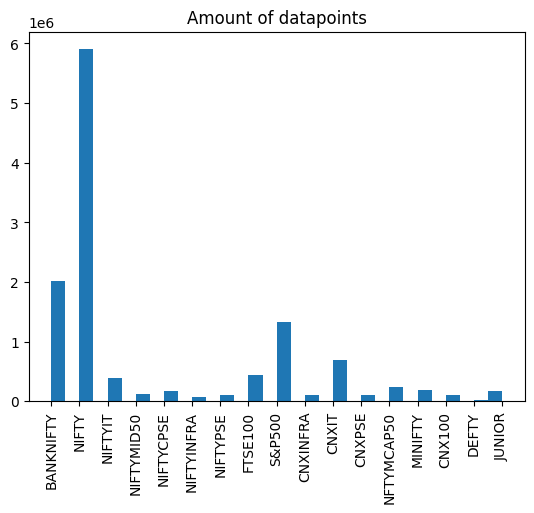

In [20]:
plt.hist(small.SYMBOL, bins=2*len(small.columns))
plt.xticks(rotation=90)
plt.title('Amount of datapoints')
plt.show()

Let us pick call options in S&P500 index.

In [21]:
data = small[(small.SYMBOL == 'S&P500') & (small.OPTION_TYP == 'CE')]

In [22]:
data = data[['EXPIRY_DT', 'TIMESTAMP', 'STRIKE_PR', 'CLOSE']]
data

,EXPIRY_DT,TIMESTAMP,STRIKE_PR,CLOSE
28101894,18-Oct-2017,18-OCT-2017,2325.0,130.15
28101895,18-Oct-2017,18-OCT-2017,2330.0,130.9
28101896,18-Oct-2017,18-OCT-2017,2335.0,121.6
28101897,18-Oct-2017,18-OCT-2017,2340.0,100.25
28101898,18-Oct-2017,18-OCT-2017,2345.0,113.3
...,...,...,...,...
75408165,15-Jun-2012,29-AUG-2011,1220.0,208.3
75408166,15-Jun-2012,29-AUG-2011,1230.0,204.3
75408167,15-Jun-2012,29-AUG-2011,1240.0,200.35
75408168,15-Jun-2012,29-AUG-2011,1250.0,196.45


In [23]:
%%time

def to_dt(x):
    try:
        return pd.to_datetime(x, format='%d-%b-%Y')
    except:
        try:
            return pd.to_datetime(x, format='%d-%b-%y')
        except:
            return np.nan
    

data['EXPIRY_DT'] = data.EXPIRY_DT.apply(to_dt)
data['TIMESTAMP'] = data.TIMESTAMP.apply(to_dt)

CPU times: user 1min 14s, sys: 245 ms, total: 1min 14s
Wall time: 1min 15s


In [24]:
data['STRIKE_PR'] = pd.to_numeric(data['STRIKE_PR'], errors='coerce')
data['CLOSE'] = pd.to_numeric(data['CLOSE'], errors='coerce') # option market price

In [25]:
data.dtypes

EXPIRY_DT    datetime64[ns]
TIMESTAMP    datetime64[ns]
STRIKE_PR           float64
CLOSE               float64
dtype: object

Let us add underlying price

In [26]:
underlying_price = marketdata[marketdata.INSTRUMENT == 'FUTIDX']

In [27]:
underlying_price = underlying_price[underlying_price.SYMBOL == 'S&P500']

In [28]:
underlying_price

,INSTRUMENT,SYMBOL,EXPIRY_DT,STRIKE_PR,OPTION_TYP,OPEN,HIGH,LOW,CLOSE,SETTLE_PR,CONTRACTS,VAL_INLAKH,OPEN_INT,CHG_IN_OI,TIMESTAMP,Unnamed: 15
28096880,FUTIDX,S&P500,18-Oct-2017,0.0,XX,2558.0,2562.25,2558.0,2560.5,2562.93,431,2757.79,130500,-99750,18-OCT-2017,NaN
28096881,FUTIDX,S&P500,15-Dec-2017,0.0,XX,2553.0,2554.75,2550.25,2552.0,2552.0,470,2998.56,188250,111750,18-OCT-2017,NaN
28096882,FUTIDX,S&P500,16-Mar-2018,0.0,XX,0.0,0.0,0.0,2540.5,2559.36,0,0.0,0,0,18-OCT-2017,NaN
28096883,FUTIDX,S&P500,15-Jun-2018,0.0,XX,0.0,0.0,0.0,2595.25,2559.36,0,0.0,0,0,18-OCT-2017,NaN
28140945,FUTIDX,S&P500,18-Oct-2017,0.0,XX,2554.0,2557.5,2554.0,2556.5,2556.5,312,1993.89,230250,-72500,17-OCT-2017,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75404831,FUTIDX,S&P500,21-Oct-2011,0.0,XX,0.0,0.0,0.0,1175.75,1193.25,0,0.0,0,0,29-AUG-2011,NaN
75404832,FUTIDX,S&P500,18-Nov-2011,0.0,XX,0.0,0.0,0.0,1184.25,1202.0,0,0.0,0,0,29-AUG-2011,NaN
75404833,FUTIDX,S&P500,16-Dec-2011,0.0,XX,0.0,0.0,0.0,1193.0,1210.75,0,0.0,0,0,29-AUG-2011,NaN
75404834,FUTIDX,S&P500,16-Mar-2012,0.0,XX,0.0,0.0,0.0,1221.5,1239.75,0,0.0,0,0,29-AUG-2011,NaN


In [29]:
%%time

underlying_price['EXPIRY_DT'] = underlying_price.EXPIRY_DT.apply(to_dt)
underlying_price['TIMESTAMP'] = underlying_price.TIMESTAMP.apply(to_dt)

CPU times: user 1.05 s, sys: 9.39 ms, total: 1.05 s
Wall time: 1.05 s


In [30]:
underlying_price['CLOSE'] = pd.to_numeric(underlying_price['CLOSE'], errors='coerce')

In [31]:
underlying_price = underlying_price[['EXPIRY_DT', 'TIMESTAMP', 'CLOSE']]

In [32]:
underlying_price

,EXPIRY_DT,TIMESTAMP,CLOSE
28096880,2017-10-18,2017-10-18,2560.50
28096881,2017-12-15,2017-10-18,2552.00
28096882,2018-03-16,2017-10-18,2540.50
28096883,2018-06-15,2017-10-18,2595.25
28140945,2017-10-18,2017-10-17,2556.50
...,...,...,...
75404831,2011-10-21,2011-08-29,1175.75
75404832,2011-11-18,2011-08-29,1184.25
75404833,2011-12-16,2011-08-29,1193.00
75404834,2012-03-16,2011-08-29,1221.50


In [33]:
underlying_price = underlying_price[underlying_price.EXPIRY_DT == underlying_price.TIMESTAMP]
underlying_price = underlying_price[['TIMESTAMP', 'CLOSE']]

underlying_price

,TIMESTAMP,CLOSE
28096880,2017-10-18,2560.50
29054525,2017-09-15,2495.50
29887623,2017-08-18,2430.75
30723345,2017-07-21,2476.50
31780596,2017-06-16,2437.00
...,...,...
72134286,2012-01-20,1310.00
72996211,2011-12-16,1223.25
73618729,2011-11-18,1223.25
74173304,2011-10-21,1217.25


So we have 73 days with matching date and timestamp, so we can assume futures price is spot price at that timestamp

In [34]:
set(underlying_price.TIMESTAMP.unique()).issubset(set(data.TIMESTAMP.unique()))

True

All the dates we have spot prices for are in our options dataframe

In [35]:
underlying_price

,TIMESTAMP,CLOSE
28096880,2017-10-18,2560.50
29054525,2017-09-15,2495.50
29887623,2017-08-18,2430.75
30723345,2017-07-21,2476.50
31780596,2017-06-16,2437.00
...,...,...
72134286,2012-01-20,1310.00
72996211,2011-12-16,1223.25
73618729,2011-11-18,1223.25
74173304,2011-10-21,1217.25


In [36]:
data

,EXPIRY_DT,TIMESTAMP,STRIKE_PR,CLOSE
28101894,2017-10-18,2017-10-18,2325.0,130.15
28101895,2017-10-18,2017-10-18,2330.0,130.90
28101896,2017-10-18,2017-10-18,2335.0,121.60
28101897,2017-10-18,2017-10-18,2340.0,100.25
28101898,2017-10-18,2017-10-18,2345.0,113.30
...,...,...,...,...
75408165,2012-06-15,2011-08-29,1220.0,208.30
75408166,2012-06-15,2011-08-29,1230.0,204.30
75408167,2012-06-15,2011-08-29,1240.0,200.35
75408168,2012-06-15,2011-08-29,1250.0,196.45


In [37]:
prices = data.merge(underlying_price, on='TIMESTAMP', how='left').dropna().rename(columns={'EXPIRY_DT': 'expiration', 'TIMESTAMP': 'ts', 'STRIKE_PR': 'strike', 'CLOSE_x': 'price', 'CLOSE_y': 'spot'}).reset_index(drop=True)

prices

,expiration,ts,strike,price,spot
0,2017-10-18,2017-10-18,2325.0,130.15,2560.5
1,2017-10-18,2017-10-18,2330.0,130.90,2560.5
2,2017-10-18,2017-10-18,2335.0,121.60,2560.5
3,2017-10-18,2017-10-18,2340.0,100.25,2560.5
4,2017-10-18,2017-10-18,2345.0,113.30,2560.5
...,...,...,...,...,...
33086,2012-06-15,2011-09-16,1290.0,206.75,1206.5
33087,2012-06-15,2011-09-16,1295.0,194.15,1206.5
33088,2012-06-15,2011-09-16,1300.0,202.80,1206.5
33089,2012-06-15,2011-09-16,1305.0,190.25,1206.5


In [38]:
prices['dt'] = prices.expiration - prices.ts
prices['dt_days'] = prices.dt.apply(lambda x: x.days)
prices['dt_years'] = prices['dt_days'] / 365

In [39]:
prices.dtypes

expiration     datetime64[ns]
ts             datetime64[ns]
strike                float64
price                 float64
spot                  float64
dt            timedelta64[ns]
dt_days                 int64
dt_years              float64
dtype: object

In [40]:
prices = prices[prices.dt_days > 0].reset_index(drop=True)

prices

,expiration,ts,strike,price,spot,dt,dt_days,dt_years
0,2017-12-15,2017-10-18,2140.0,237.35,2560.5,58 days,58,0.158904
1,2017-12-15,2017-10-18,2150.0,241.60,2560.5,58 days,58,0.158904
2,2017-12-15,2017-10-18,2160.0,254.30,2560.5,58 days,58,0.158904
3,2017-12-15,2017-10-18,2165.0,247.25,2560.5,58 days,58,0.158904
4,2017-12-15,2017-10-18,2170.0,246.60,2560.5,58 days,58,0.158904
...,...,...,...,...,...,...,...,...
27213,2012-06-15,2011-09-16,1290.0,206.75,1206.5,273 days,273,0.747945
27214,2012-06-15,2011-09-16,1295.0,194.15,1206.5,273 days,273,0.747945
27215,2012-06-15,2011-09-16,1300.0,202.80,1206.5,273 days,273,0.747945
27216,2012-06-15,2011-09-16,1305.0,190.25,1206.5,273 days,273,0.747945


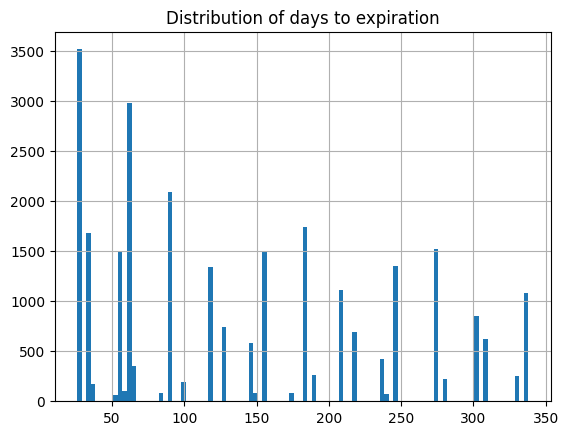

In [41]:
plt.hist(prices.dt_days, bins=100)
plt.title('Distribution of days to expiration')
plt.grid()
plt.show()

In [42]:
with open('prices.pkl', 'wb') as file:
    pickle.dump(prices, file)

In [43]:
!ls

bs_solution-Copy1.ipynb main.fdb_latexmk        main.toc
bs_solution.ipynb       main.fls                marketdata_path.txt
fobhav.csv              main.log                pngs
main.aux                main.pdf                prices.pkl
main.bbl                main.run.xml            result
main.bcf                main.synctex.gz         title.tex
main.blg                main.tex


In [44]:
with open('prices.pkl', 'rb') as file:
    prices = pickle.load(file)

In [45]:
prices

,expiration,ts,strike,price,spot,dt,dt_days,dt_years
0,2017-12-15,2017-10-18,2140.0,237.35,2560.5,58 days,58,0.158904
1,2017-12-15,2017-10-18,2150.0,241.60,2560.5,58 days,58,0.158904
2,2017-12-15,2017-10-18,2160.0,254.30,2560.5,58 days,58,0.158904
3,2017-12-15,2017-10-18,2165.0,247.25,2560.5,58 days,58,0.158904
4,2017-12-15,2017-10-18,2170.0,246.60,2560.5,58 days,58,0.158904
...,...,...,...,...,...,...,...,...
27213,2012-06-15,2011-09-16,1290.0,206.75,1206.5,273 days,273,0.747945
27214,2012-06-15,2011-09-16,1295.0,194.15,1206.5,273 days,273,0.747945
27215,2012-06-15,2011-09-16,1300.0,202.80,1206.5,273 days,273,0.747945
27216,2012-06-15,2011-09-16,1305.0,190.25,1206.5,273 days,273,0.747945


Great! Now we get our dataset to calibrate, compare and fit our models. Now let us turn to calubration and comparation.

# Calibrating and Fitting Models with Differential Evolution

[differential evolution](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.differential_evolution.html) algorithm used to calibrate and somehow improve the model price predict

## Black-Scholes

We assume r (risk-free rate) and sigma (volatility of returns) are constant in long period - they are both the only constant parameters for simple BS

In [46]:
bs_x = prices.drop(columns='price')
bs_y = prices['price']

X_train, X_test, y_train, y_test = train_test_split(bs_x, bs_y, test_size=0.2, random_state=42, shuffle=False)

In [47]:
r = 0.02
sigma = 0.34

X_train['price_predict'] = black_scholes_call_price(X_train['spot'], X_train['strike'], X_train['dt_years'], r, sigma)

rmse_value = np.sqrt(mean_squared_error(y_train, X_train['price_predict']))
r2_value = r2_score(y_train, X_train['price_predict'])

rmse_value, r2_value

(88.40783159176277, -0.17350462653587284)

BS ready for DE optimization. Let us try it:

In [48]:
def calculate_rmse(x):
    r, sigma = 10 ** x[0], 10 ** x[1]
    
    X_train['price_predict'] = black_scholes_call_price(X_train['spot'], X_train['strike'], X_train['dt_years'], r, sigma)
    rmse_value = np.sqrt(mean_squared_error(y_train, X_train['price_predict']))
    r2_value = r2_score(y_train, X_train['price_predict'])

    return rmse_value


# Bounds for the variables r, sigma
bounds = [(-6, -1), (-4, 0)]

result = differential_evolution(calculate_rmse, bounds, strategy='best1bin', maxiter=1000, popsize=10, tol=1e-7, disp=True, seed=42)

best_solution = result.x
best_rmse = result.fun

# Calibration Results
print("\nBest Solution:", best_solution)
print("Best RMSE Reached:", best_rmse)

differential_evolution step 1: f(x)= 69.9015
differential_evolution step 2: f(x)= 69.9015
differential_evolution step 3: f(x)= 69.9015
differential_evolution step 4: f(x)= 69.9007
differential_evolution step 5: f(x)= 69.9007
differential_evolution step 6: f(x)= 69.9007
differential_evolution step 7: f(x)= 69.9007
differential_evolution step 8: f(x)= 69.9002
differential_evolution step 9: f(x)= 69.9002
differential_evolution step 10: f(x)= 69.9002
differential_evolution step 11: f(x)= 69.9001
differential_evolution step 12: f(x)= 69.9001
differential_evolution step 13: f(x)= 69.9001
differential_evolution step 14: f(x)= 69.9001
differential_evolution step 15: f(x)= 69.9001
differential_evolution step 16: f(x)= 69.9001
differential_evolution step 17: f(x)= 69.9001
differential_evolution step 18: f(x)= 69.9001
differential_evolution step 19: f(x)= 69.9001
differential_evolution step 20: f(x)= 69.9001
differential_evolution step 21: f(x)= 69.9001
differential_evolution step 22: f(x)= 69.90

In [49]:
10 ** -6, 10 ** (-0.609)

(1e-06, 0.24603676041476275)

### Test Result

In [50]:
r_best = 0
sigma_best = 0.24603676041476275

X_test['price_predict'] = black_scholes_call_price(X_test['spot'], X_test['strike'], X_test['dt_years'], r_best, sigma_best)
X_test['target'] = y_test
X_test = X_test.reset_index(drop=True)

simple_bs_predict = X_test['price_predict']

In [51]:
X_test

,expiration,ts,strike,spot,dt,dt_days,dt_years,price_predict,target
0,2013-06-21,2012-12-21,1435.0,1426.25,182 days,182,0.498630,94.719042,125.85
1,2013-06-21,2012-12-21,1440.0,1426.25,182 days,182,0.498630,92.481751,128.55
2,2013-06-21,2012-12-21,1445.0,1426.25,182 days,182,0.498630,90.283924,121.20
3,2013-06-21,2012-12-21,1450.0,1426.25,182 days,182,0.498630,88.125306,123.70
4,2013-06-21,2012-12-21,1455.0,1426.25,182 days,182,0.498630,86.005627,116.85
...,...,...,...,...,...,...,...,...,...
5439,2012-06-15,2011-09-16,1290.0,1206.50,273 days,273,0.747945,69.177168,206.75
5440,2012-06-15,2011-09-16,1295.0,1206.50,273 days,273,0.747945,67.509133,194.15
5441,2012-06-15,2011-09-16,1300.0,1206.50,273 days,273,0.747945,65.873967,202.80
5442,2012-06-15,2011-09-16,1305.0,1206.50,273 days,273,0.747945,64.271278,190.25


In [52]:
rmse_score = np.sqrt(mean_squared_error(X_test['target'], X_test['price_predict']))
rmse_score

62.93773615689657

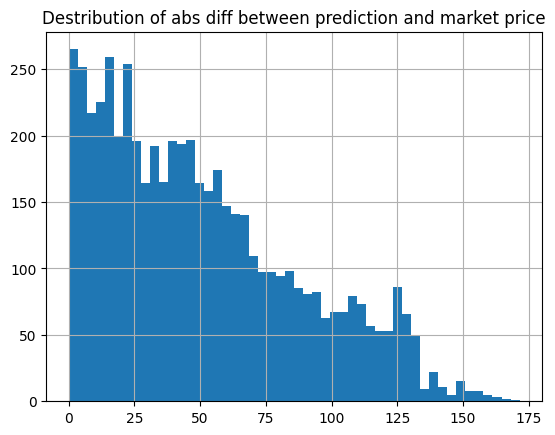

In [53]:
plt.hist((X_test['price_predict'] - X_test['target']).abs(), bins=50)
plt.grid()
plt.title('Destribution of abs diff between prediction and market price')
plt.show()

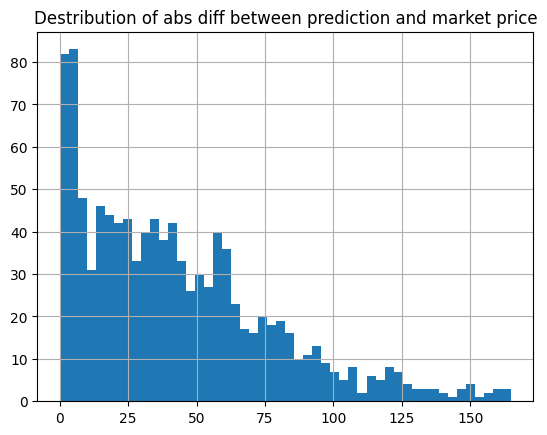

In [54]:
X_masked = X_test[X_test.dt_years < 0.1]

plt.hist((X_masked['price_predict'] - X_masked['target']).abs(), bins=50)
plt.grid()
plt.title('Destribution of abs diff between prediction and market price')
plt.show()

Error and miscalculation are pretty big, especially at the cases with big time to maturity

## BS+SABR

In SABR model we have constant r, alpha, beta, rho and nu parameters.

In [55]:
sabr_x = prices.drop(columns='price')
sabr_y = prices['price']

X_train, X_test, y_train, y_test = train_test_split(bs_x, bs_y, test_size=0.2, random_state=42, shuffle=False)

In [56]:
r = 0.02
alpha = 1.63
beta = 0.6
rho = -0.09
nu = 1.3
K = X_train['strike']
S = X_train['spot']
T = X_train['dt_years']
implied_vol = np.array([ql.sabrVolatility(K[i], S[i], T[i], alpha, beta, nu, rho) for i in range(len(T))])

X_train['price_predict'] = black_scholes_call_price(X_train['spot'], X_train['strike'], X_train['dt_years'], r, implied_vol) # SABR prediction with implied volatility

rmse_value = np.sqrt(mean_squared_error(y_train, X_train['price_predict']))
r2_value = r2_score(y_train, X_train['price_predict'])

rmse_value, r2_value

(92.39598424002622, -0.2817682837195121)

BS+SABR also ready for DE optimization

In [57]:
K = X_train['strike']
S = X_train['spot']
T = X_train['dt_years']


def calculate_rmse_sabr(x):
    r, alpha, beta, rho, nu = 10 ** x[0], 10 ** x[1], 10 ** x[2], 10 ** x[3] - 1, 10 ** x[4]
    implied_vol = np.array([ql.sabrVolatility(K[i], S[i], T[i], alpha, beta, nu, rho) for i in range(len(T))])
    
    X_train['price_predict'] = black_scholes_call_price(X_train['spot'], X_train['strike'], X_train['dt_years'], r, implied_vol) # SABR prediction with implied volatility
    contains_nan = X_train['price_predict'].isna().any()
    if contains_nan:
        return 1000
    else:
        rmse_value = np.sqrt(mean_squared_error(y_train, X_train['price_predict']))
        r2_value = r2_score(y_train, X_train['price_predict'])

        return rmse_value


# Bounds for the variables r, alpha, beta, rho, nu
bounds = [(-6, -0.5), (-4, 3), (-6, 0), (-6, np.log(2) / np.log(10) - 1e-6), (-5, 3)]

result = differential_evolution(calculate_rmse_sabr, bounds, strategy='best1bin', maxiter=1000, popsize=10, tol=1e-7, disp=True, seed=42)

best_solution = result.x
best_rmse = result.fun

# Calibration Results
print("\nBest Solution:", best_solution)
print("Best RMSE Reached:", best_rmse)

differential_evolution step 1: f(x)= 76.1874
differential_evolution step 2: f(x)= 72.967
differential_evolution step 3: f(x)= 72.967
differential_evolution step 4: f(x)= 72.5026
differential_evolution step 5: f(x)= 70.7206
differential_evolution step 6: f(x)= 70.7206
differential_evolution step 7: f(x)= 70.6201
differential_evolution step 8: f(x)= 70.109
differential_evolution step 9: f(x)= 69.9485
differential_evolution step 10: f(x)= 69.9485
differential_evolution step 11: f(x)= 69.9462
differential_evolution step 12: f(x)= 69.9458
differential_evolution step 13: f(x)= 69.9457
differential_evolution step 14: f(x)= 69.9457
differential_evolution step 15: f(x)= 69.9457
differential_evolution step 16: f(x)= 69.9444
differential_evolution step 17: f(x)= 69.8965
differential_evolution step 18: f(x)= 69.8457
differential_evolution step 19: f(x)= 69.8457
differential_evolution step 20: f(x)= 69.8457
differential_evolution step 21: f(x)= 69.8449
differential_evolution step 22: f(x)= 69.8449


differential_evolution step 178: f(x)= 65.2142
differential_evolution step 179: f(x)= 65.2142
differential_evolution step 180: f(x)= 65.2142
differential_evolution step 181: f(x)= 65.2142
differential_evolution step 182: f(x)= 65.2142
differential_evolution step 183: f(x)= 65.2142
differential_evolution step 184: f(x)= 65.2142
differential_evolution step 185: f(x)= 65.2142
differential_evolution step 186: f(x)= 65.2142
differential_evolution step 187: f(x)= 65.2142
differential_evolution step 188: f(x)= 65.2141
differential_evolution step 189: f(x)= 65.2141
differential_evolution step 190: f(x)= 65.2141
differential_evolution step 191: f(x)= 65.2141
differential_evolution step 192: f(x)= 65.2141
differential_evolution step 193: f(x)= 65.2141
differential_evolution step 194: f(x)= 65.2141
differential_evolution step 195: f(x)= 65.2141
differential_evolution step 196: f(x)= 65.2141
differential_evolution step 197: f(x)= 65.2141
differential_evolution step 198: f(x)= 65.2141
differential_

### Test Result

In [58]:
r_best, alpha_best, beta_best, rho_best, nu_best = 0, 10 ** 2.06388218, 10 ** (-0.67433803), 10 ** 0.30102893 - 1, 10 ** 0.25200498
r_best, alpha_best, beta_best, rho_best, nu_best

(0,
 115.84630334174425,
 0.21167129655322528,
 0.9999950924420264,
 1.7865080603970032)

In [59]:
X_test = X_test.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)

In [60]:
K = X_test['strike']
S = X_test['spot']
T = X_test['dt_years']

implied_vol = np.array([ql.sabrVolatility(K[i], S[i], T[i], alpha_best, beta_best, nu_best, rho_best) for i in range(len(T))])
    
X_test['sabr_predict'] = black_scholes_call_price(X_test['spot'], X_test['strike'], X_test['dt_years'], r_best, implied_vol)
X_test['target'] = y_test

In [63]:
X_test

,expiration,ts,strike,spot,dt,dt_days,dt_years,sabr_predict,target
0,2013-06-21,2012-12-21,1435.0,1426.25,182 days,182,0.498630,142.175964,125.85
1,2013-06-21,2012-12-21,1440.0,1426.25,182 days,182,0.498630,140.961199,128.55
2,2013-06-21,2012-12-21,1445.0,1426.25,182 days,182,0.498630,139.765739,121.20
3,2013-06-21,2012-12-21,1450.0,1426.25,182 days,182,0.498630,138.589106,123.70
4,2013-06-21,2012-12-21,1455.0,1426.25,182 days,182,0.498630,137.430836,116.85
...,...,...,...,...,...,...,...,...,...
5439,2012-06-15,2011-09-16,1290.0,1206.50,273 days,273,0.747945,151.762071,206.75
5440,2012-06-15,2011-09-16,1295.0,1206.50,273 days,273,0.747945,150.957177,194.15
5441,2012-06-15,2011-09-16,1300.0,1206.50,273 days,273,0.747945,150.162141,202.80
5442,2012-06-15,2011-09-16,1305.0,1206.50,273 days,273,0.747945,149.376748,190.25


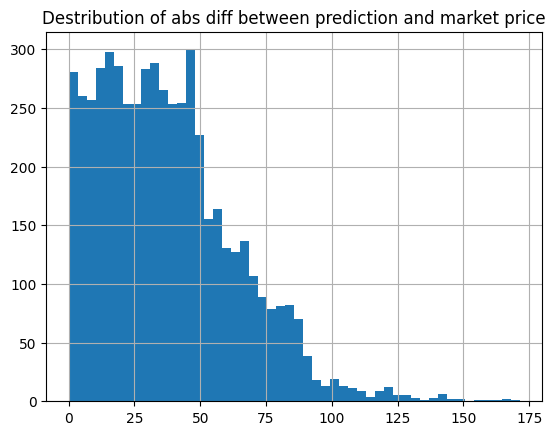

In [64]:
plt.hist((X_test['sabr_predict'] - X_test['target']).abs(), bins=50)
plt.grid()
plt.title('Destribution of abs diff between prediction and market price')
plt.show()

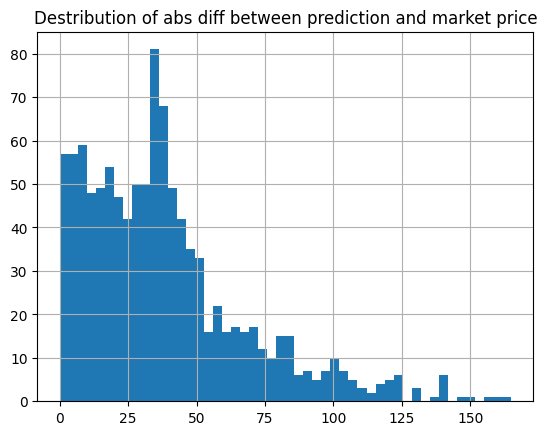

In [66]:
X_masked = X_test[X_test.dt_years < 0.1]

plt.hist((X_masked['sabr_predict'] - X_masked['target']).abs(), bins=50)
plt.grid()
plt.title('Destribution of abs diff between prediction and market price')
plt.show()

The result is also not that great, but still better than basic BS

# Compare Results

Although it is easy to see how result differ and it is obvious that BS+SABR model performs better

In [67]:
r_best, sigma_best = 0, 0.24603676041476275

alpha_best, beta_best, rho_best, nu_best = 10 ** 2.06388218, 10 ** (-0.67433803), 10 ** 0.30102893 - 1, 10 ** 0.25200498

In [68]:
X_test['bs_predict'] = simple_bs_predict
if 'price_predict' in X_test.columns:
    X_test = X_test.drop(columns=['price_predict'])

X_test

,expiration,ts,strike,spot,dt,dt_days,dt_years,sabr_predict,target,bs_predict
0,2013-06-21,2012-12-21,1435.0,1426.25,182 days,182,0.498630,142.175964,125.85,94.719042
1,2013-06-21,2012-12-21,1440.0,1426.25,182 days,182,0.498630,140.961199,128.55,92.481751
2,2013-06-21,2012-12-21,1445.0,1426.25,182 days,182,0.498630,139.765739,121.20,90.283924
3,2013-06-21,2012-12-21,1450.0,1426.25,182 days,182,0.498630,138.589106,123.70,88.125306
4,2013-06-21,2012-12-21,1455.0,1426.25,182 days,182,0.498630,137.430836,116.85,86.005627
...,...,...,...,...,...,...,...,...,...,...
5439,2012-06-15,2011-09-16,1290.0,1206.50,273 days,273,0.747945,151.762071,206.75,69.177168
5440,2012-06-15,2011-09-16,1295.0,1206.50,273 days,273,0.747945,150.957177,194.15,67.509133
5441,2012-06-15,2011-09-16,1300.0,1206.50,273 days,273,0.747945,150.162141,202.80,65.873967
5442,2012-06-15,2011-09-16,1305.0,1206.50,273 days,273,0.747945,149.376748,190.25,64.271278


In [69]:
bs_rmse_score = np.sqrt(mean_squared_error(X_test['target'], X_test['bs_predict']))
sabr_rmse_score = np.sqrt(mean_squared_error(X_test['target'], X_test['sabr_predict']))

bs_rmse_score, sabr_rmse_score

(62.93773615689657, 45.647942369951814)

## Wow, sabr improves RMSE metric on test from 62 to 45. That's sugnificant result

Let us check how the pricing results look like

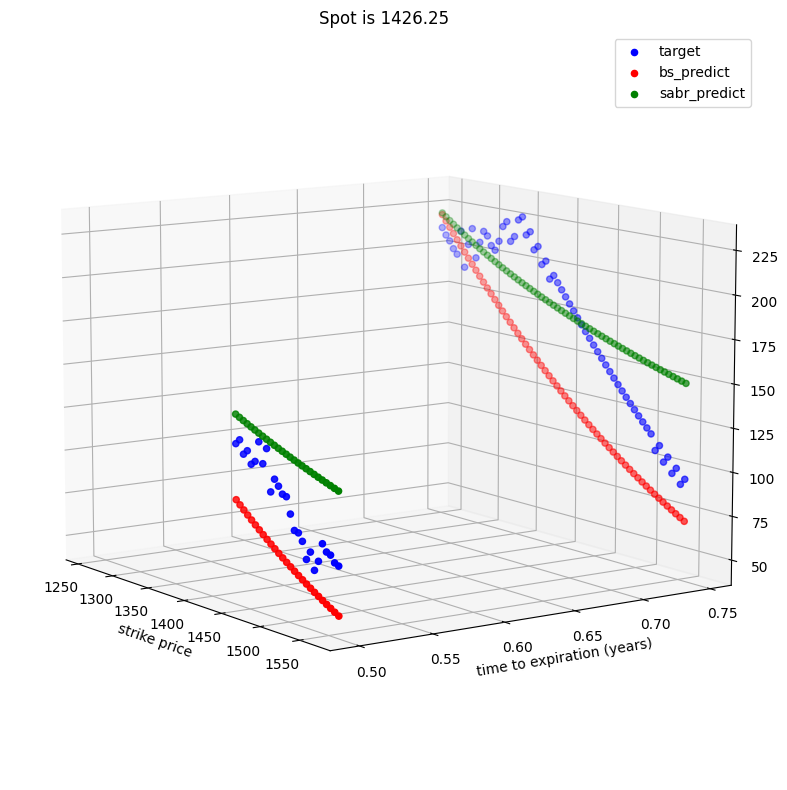

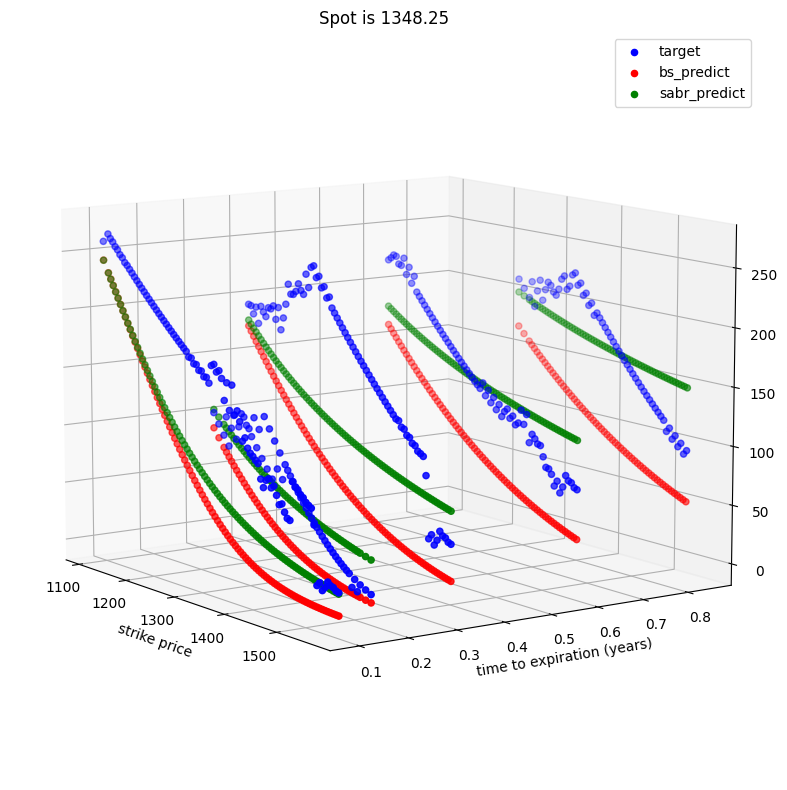

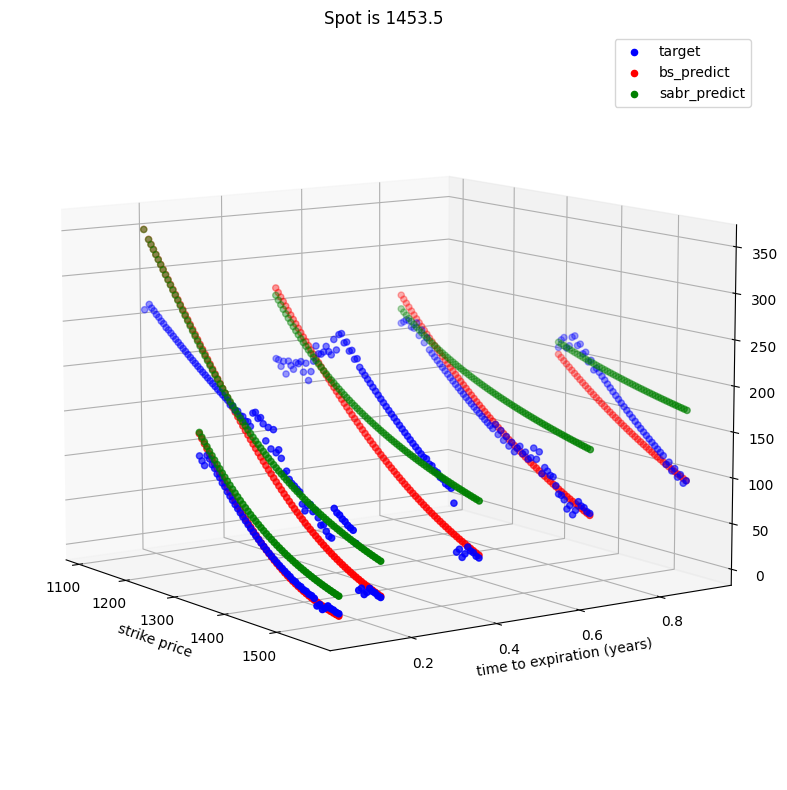

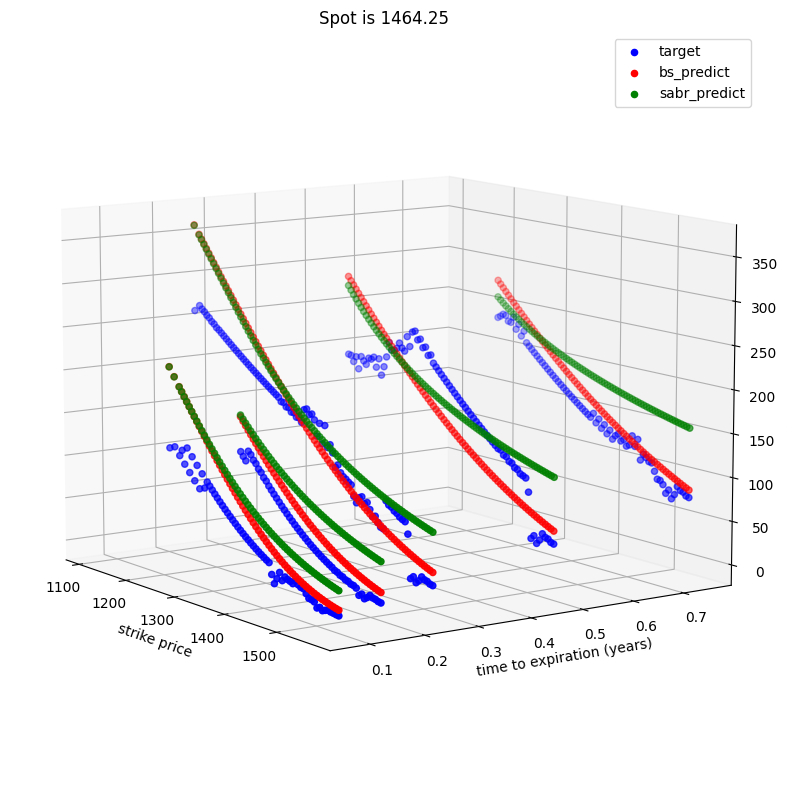

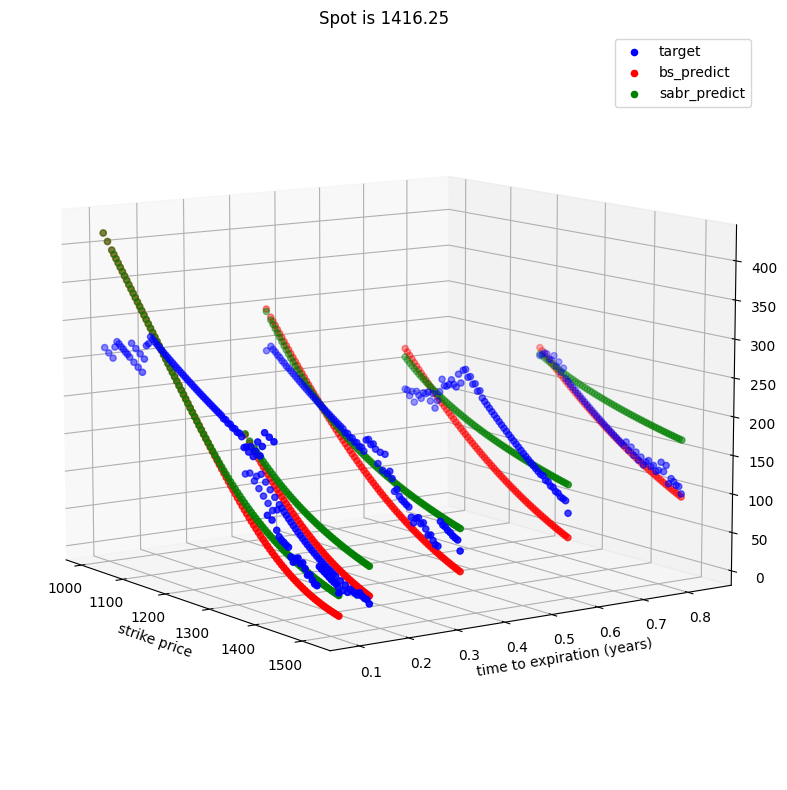

...

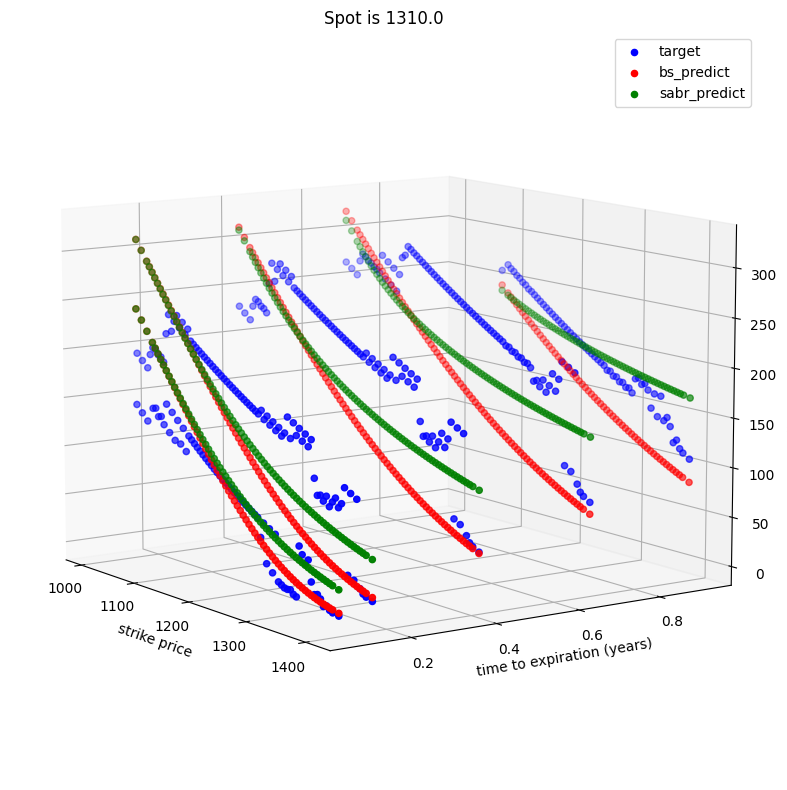

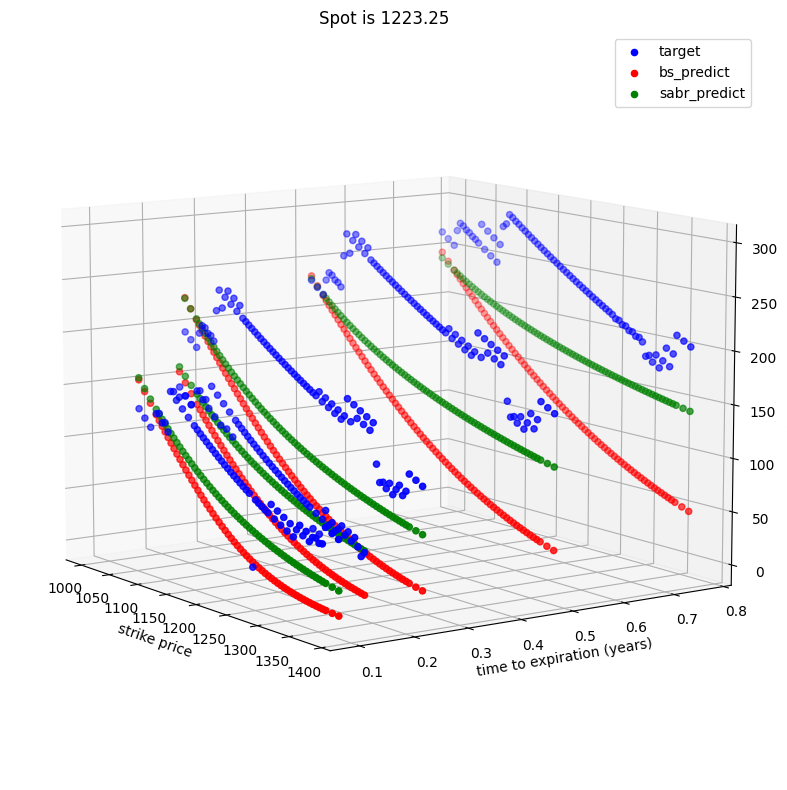

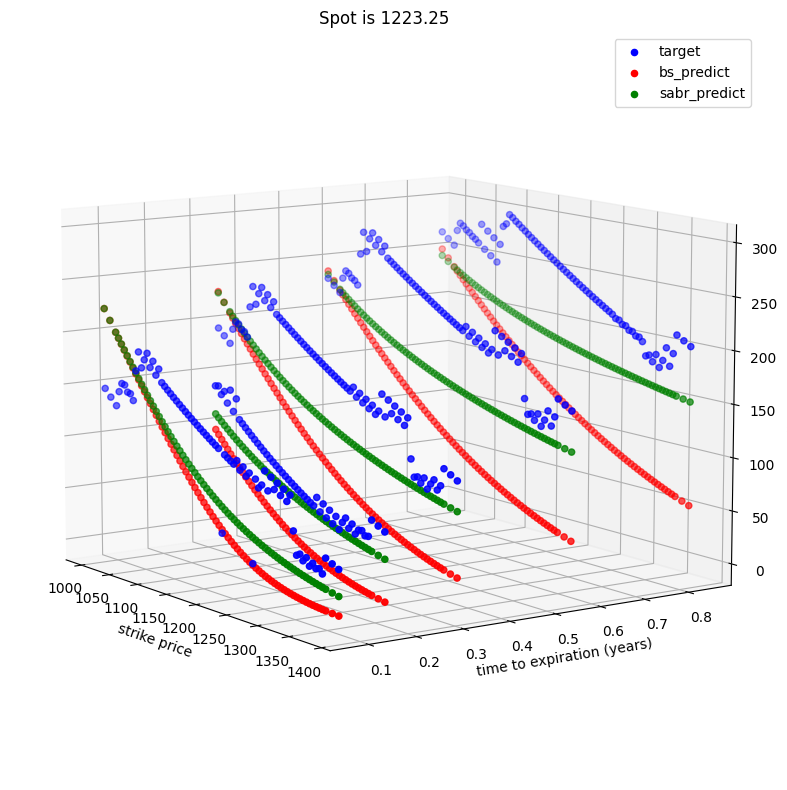

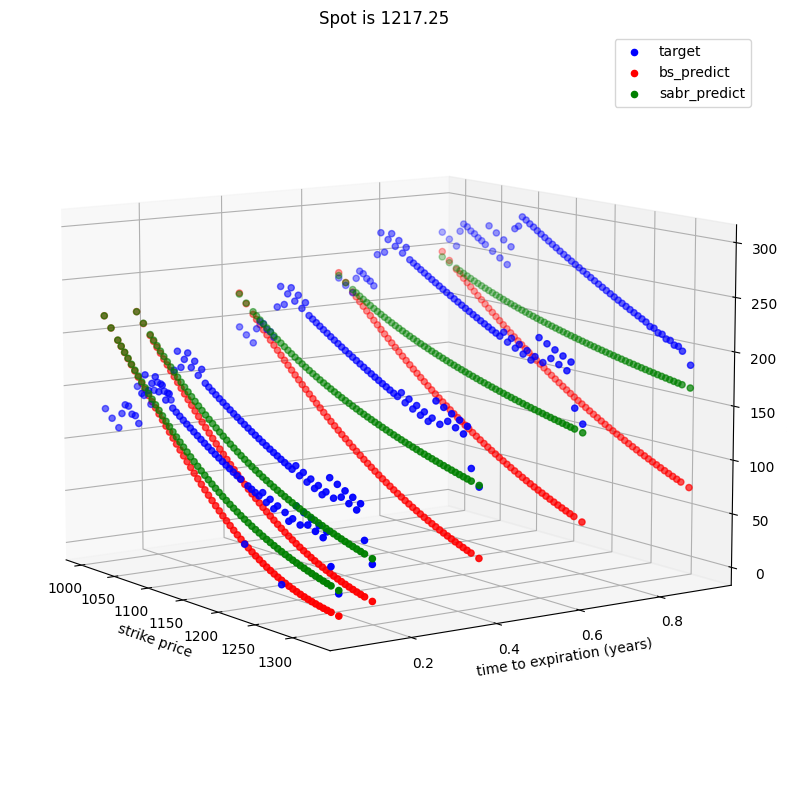

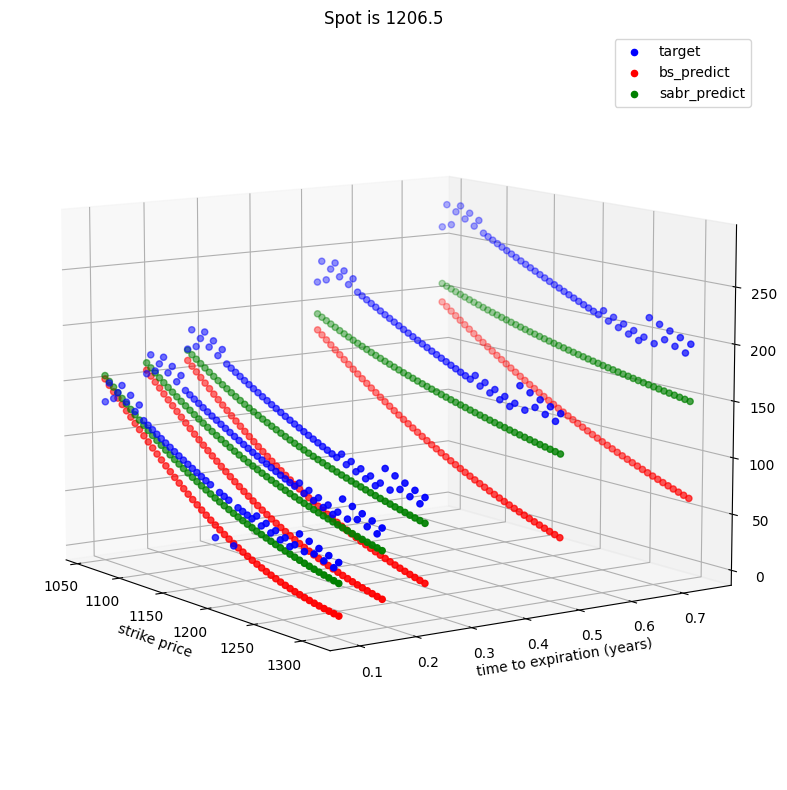

In [70]:
for date in X_test.ts.unique():
    tmp = X_test[X_test.ts == date].reset_index(drop=True)
    
    spot = tmp.spot[0]

    x = tmp['strike']
    y = tmp['dt_years']

    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')

    colors = ['blue', 'red', 'green']
    for i, z_key in enumerate(['target', 'bs_predict', 'sabr_predict']):
        z = tmp[z_key]
        ax.scatter(x, y, z, marker='o', label=z_key, color=colors[i])

    ax.set_xlabel('strike price')
    ax.set_ylabel('time to expiration (years)')
    ax.set_zlabel('option price')
    plt.title(f'Spot is {tmp.spot[0]}')

    # Change the rotation
    elevation_angle = 10  # in degrees
    azimuth_angle = -35  # in degrees
    ax.view_init(elevation_angle, azimuth_angle)
    
    plt.tight_layout()
    plt.legend()

    name = str(date)[:10]
    plt.savefig(f'/Users/mark/Desktop/hse/course_work/success/pngs/compare_test/3d/{name}.png')
    plt.show()

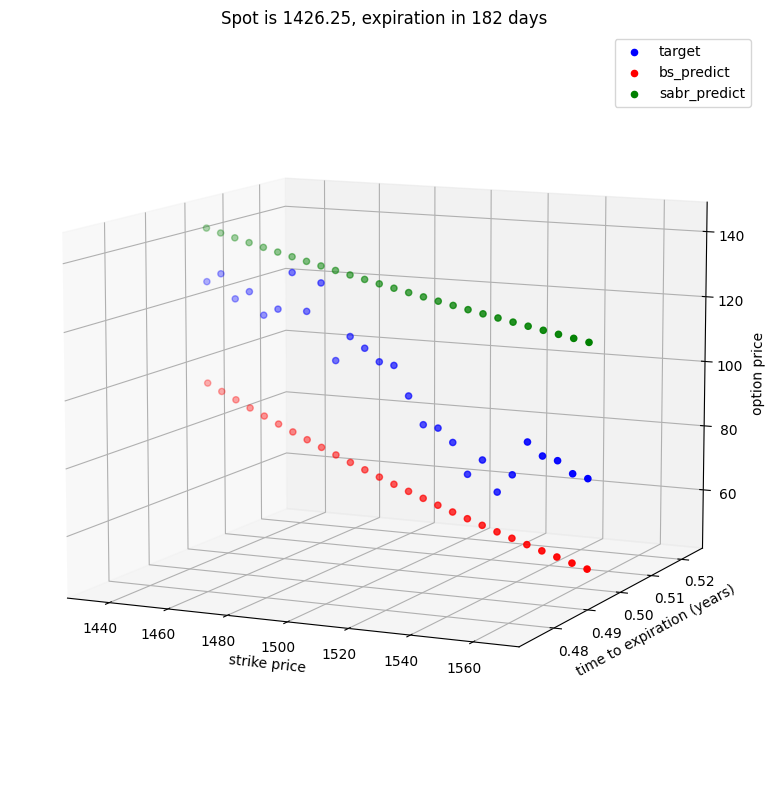

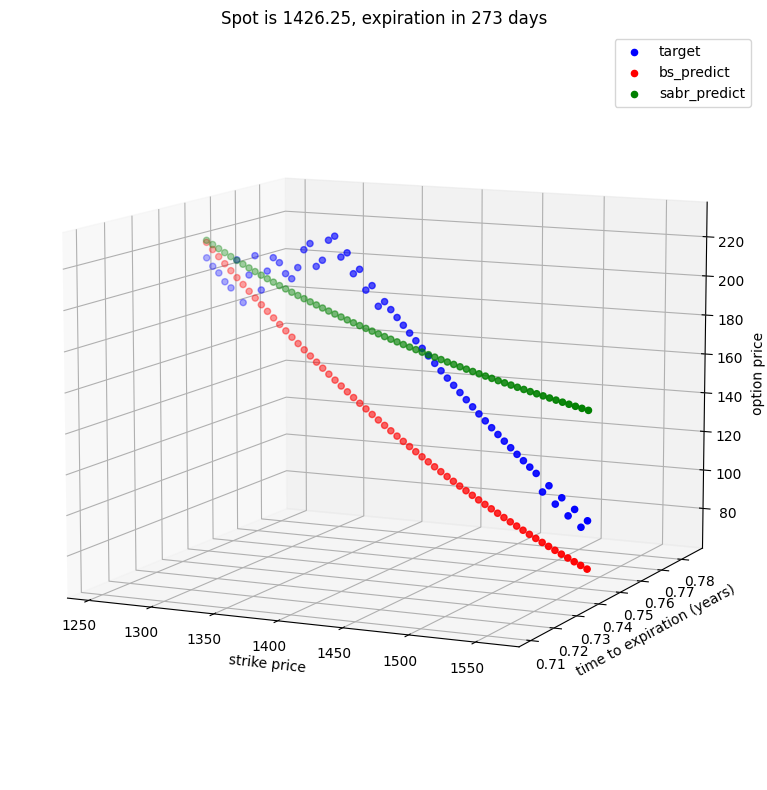

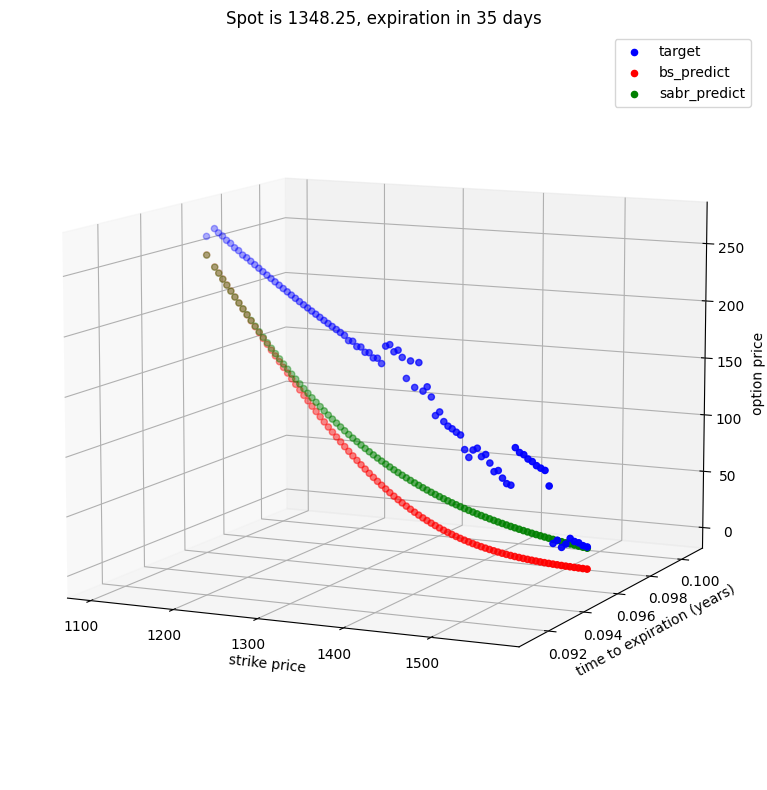

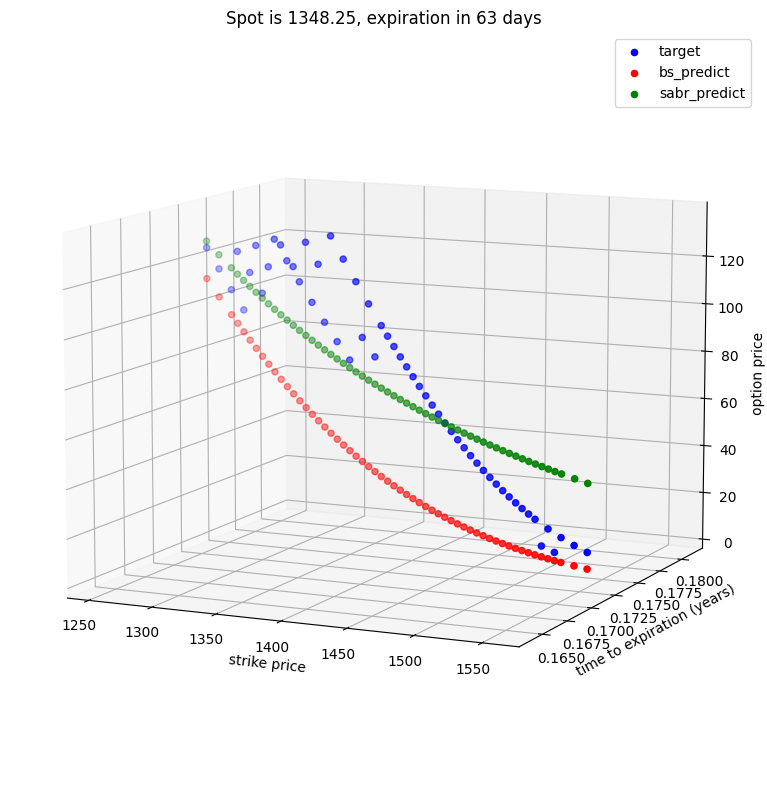

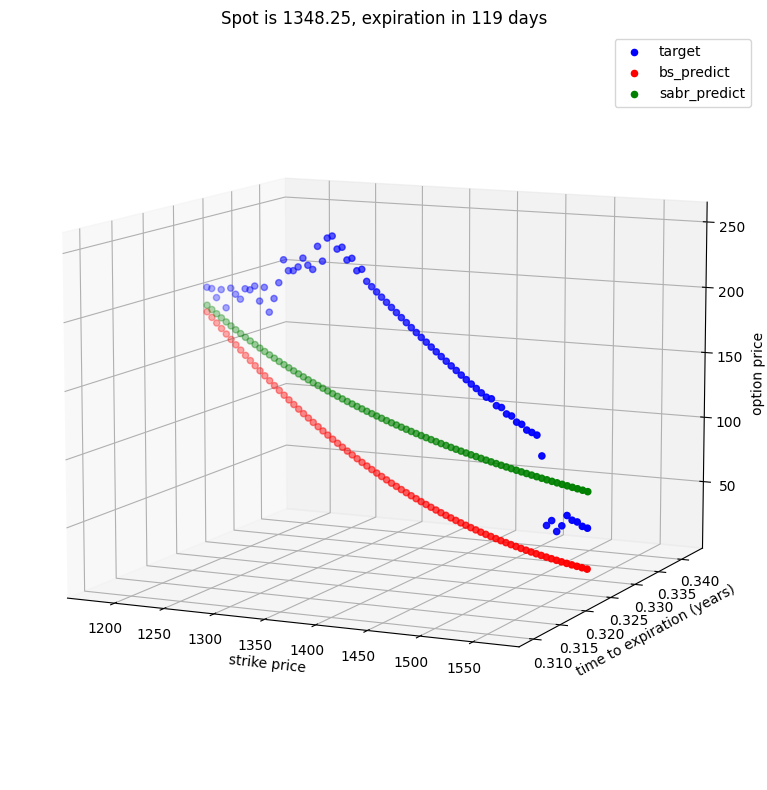

...

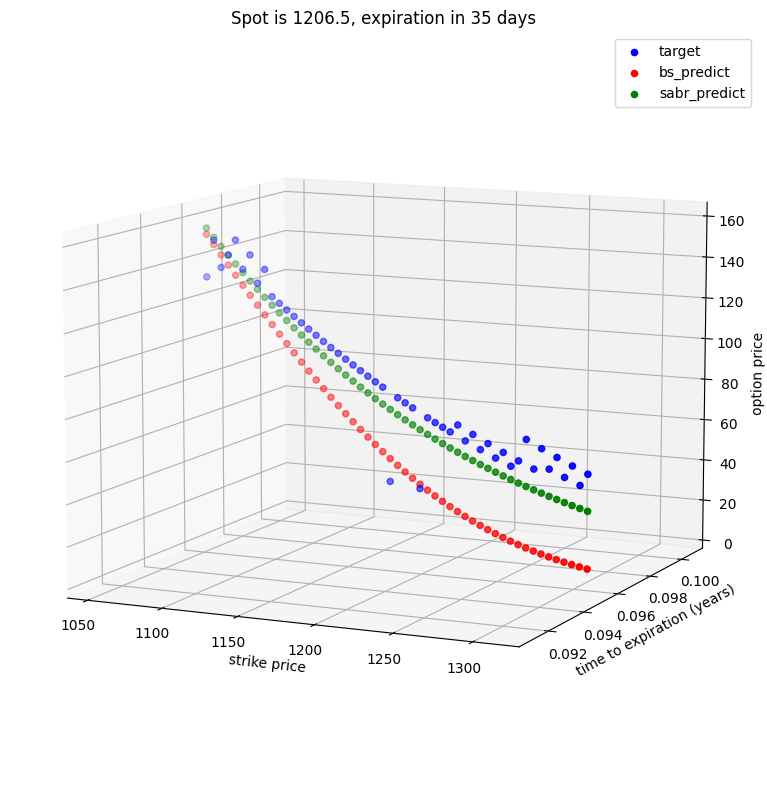

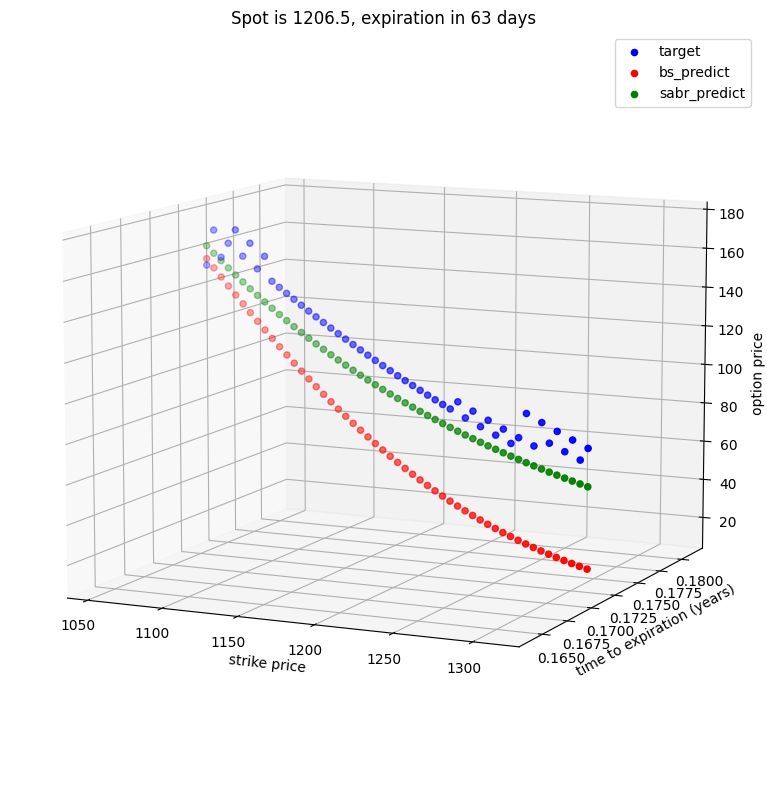

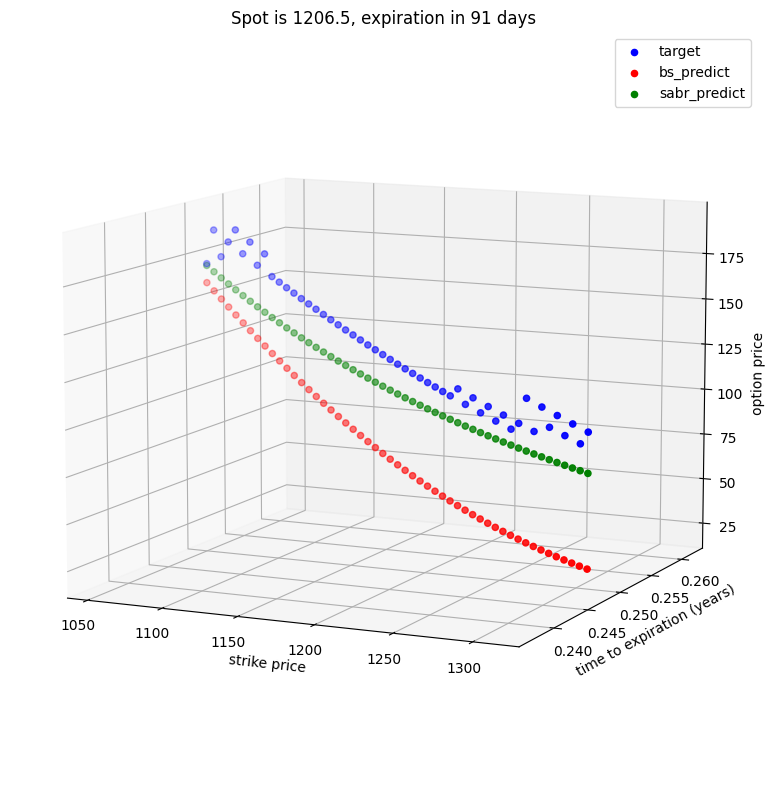

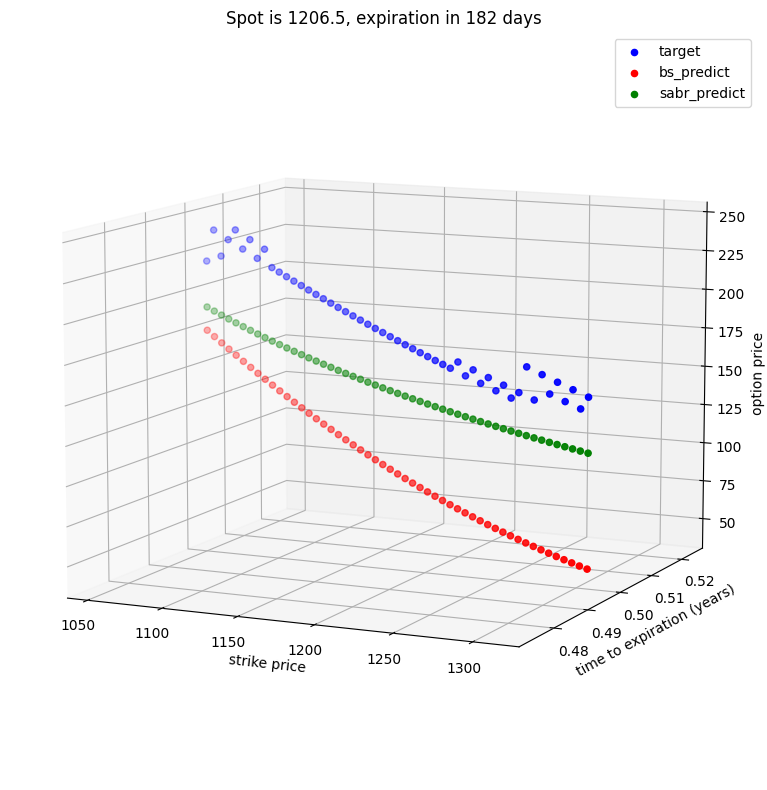

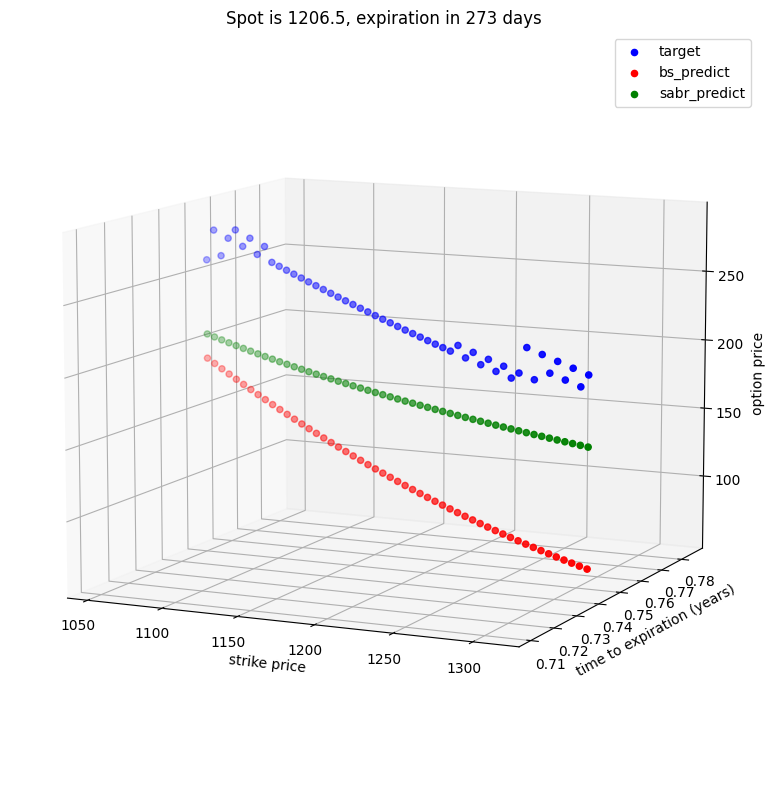

In [71]:
for date in X_test.ts.unique():
    tmp = X_test[X_test.ts == date].reset_index(drop=True)
    
    random_picker = np.random.randint(len(tmp.dt_days.unique()))
    for i, expiration in enumerate(tmp.dt_days.unique()): 
        tmp_dated = tmp[tmp.dt_days == expiration].reset_index(drop=True)

        spot = tmp_dated.spot[0]
        x = tmp_dated['strike']
        y = tmp_dated['dt_years']

        fig = plt.figure(figsize=(8, 8))
        ax = fig.add_subplot(111, projection='3d')

        colors = ['blue', 'red', 'green']
        for i, z_key in enumerate(['target', 'bs_predict', 'sabr_predict']):
            z = tmp_dated[z_key]
            ax.scatter(x, y, z, marker='o', label=z_key, color=colors[i])

        ax.set_xlabel('strike price')
        ax.set_ylabel('time to expiration (years)')
        ax.set_zlabel('option price')
        plt.title(f'Spot is {tmp_dated.spot[0]}, expiration in {expiration} days')

        # Change the rotation
        elevation_angle = 10  # in degrees
        azimuth_angle = -65  # in degrees
        ax.view_init(elevation_angle, azimuth_angle)

        plt.tight_layout()
        plt.legend()

        name = str(date)[:10] + "-" + str(expiration)
        plt.savefig(f'/Users/mark/Desktop/hse/course_work/success/pngs/compare_test/2d/{name}.png')
        plt.show()

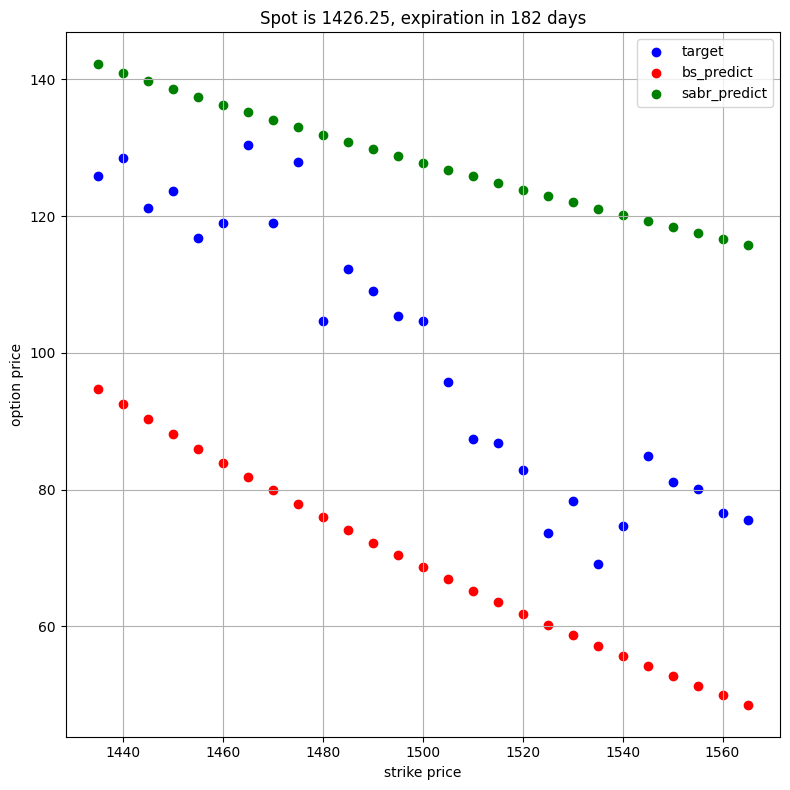

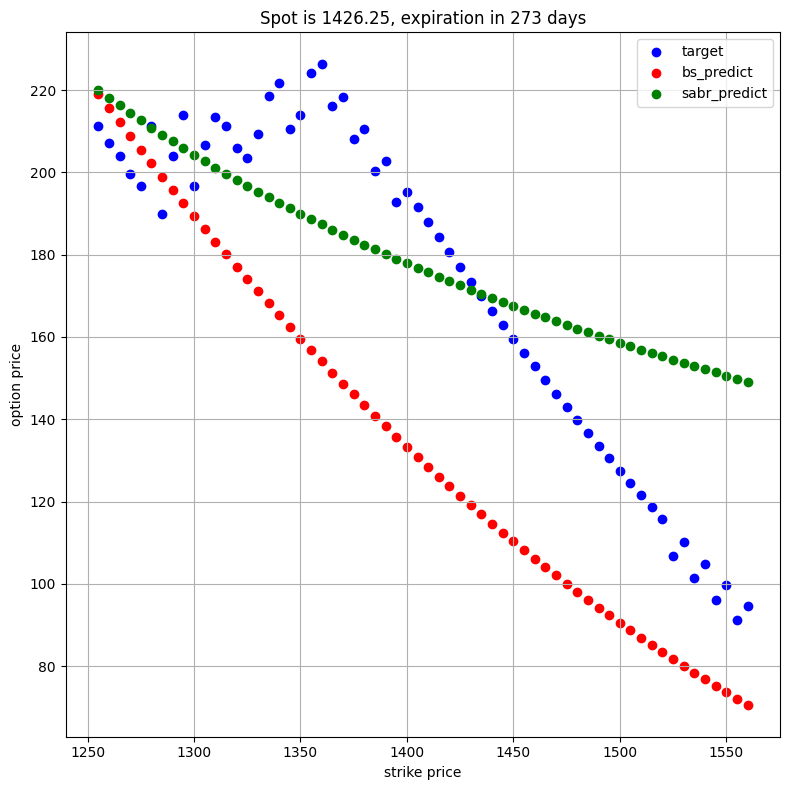

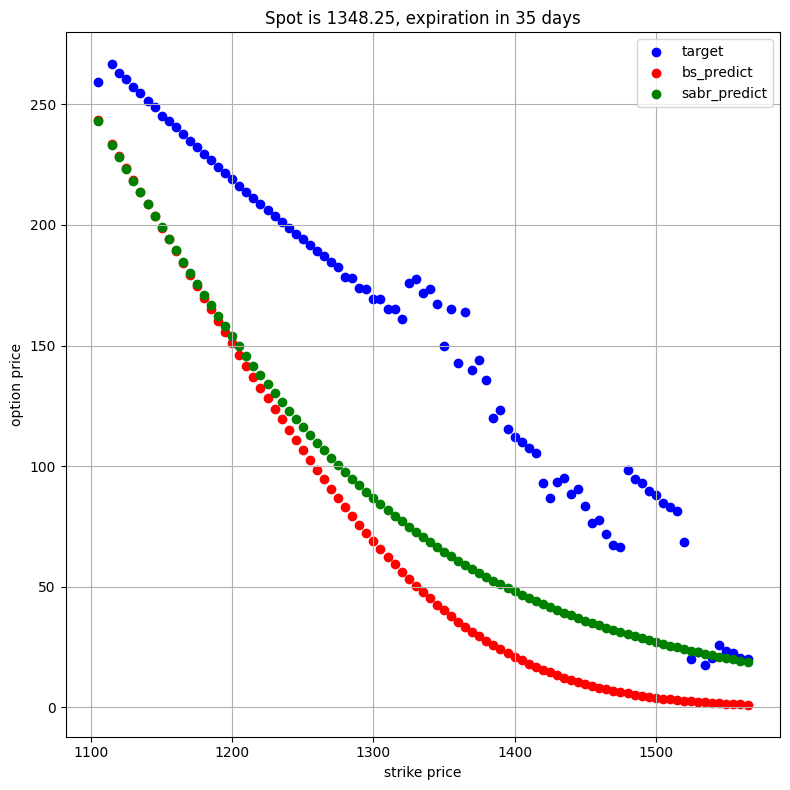

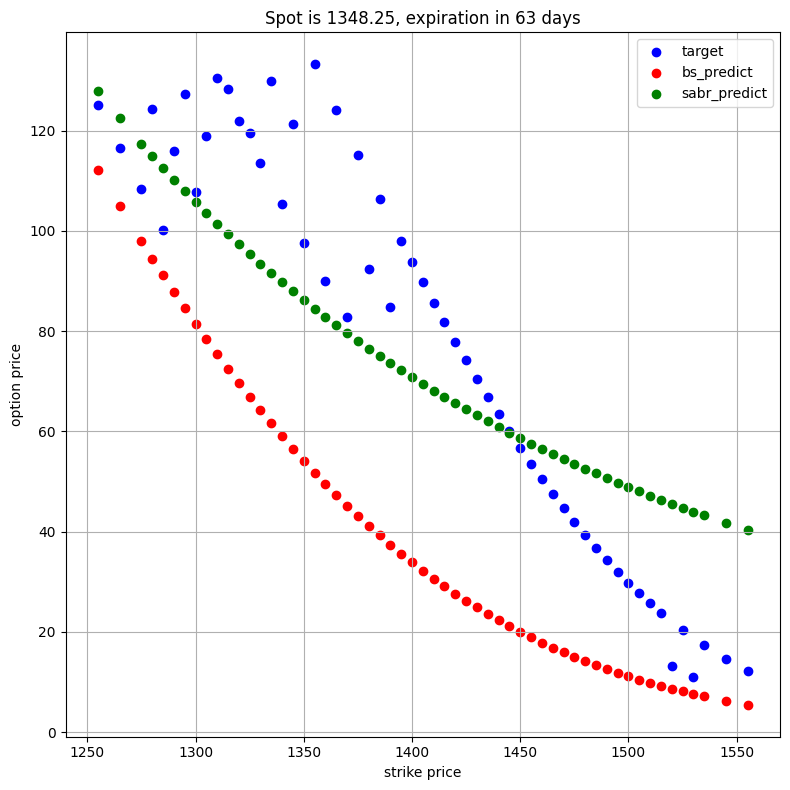

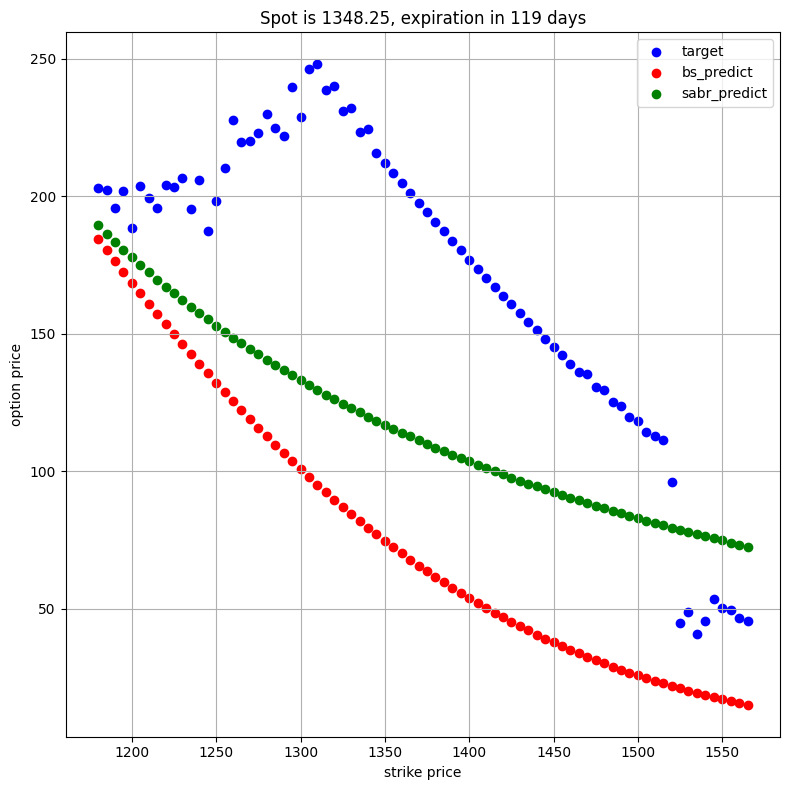

...

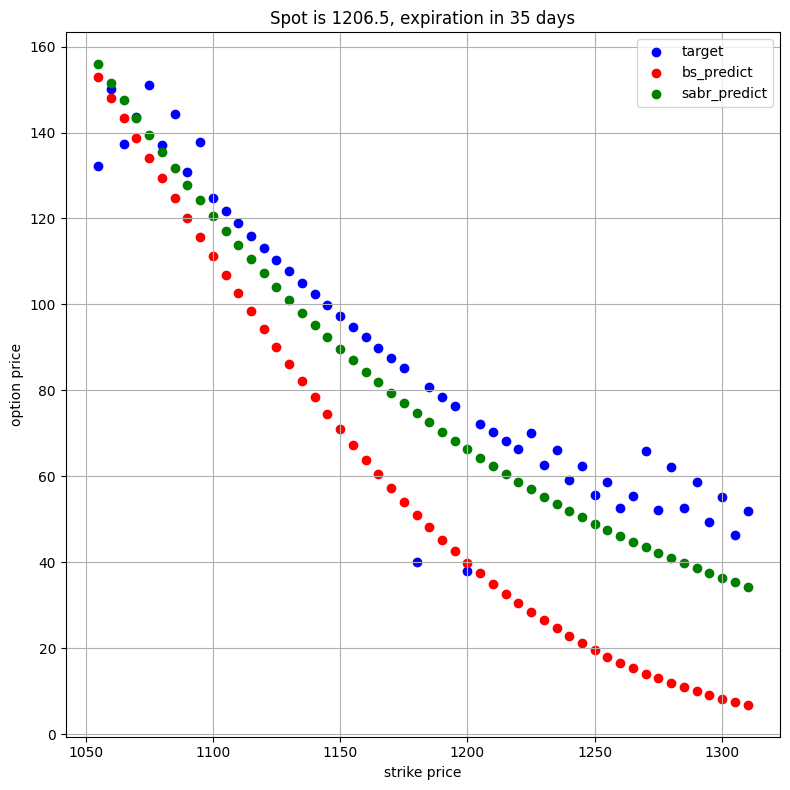

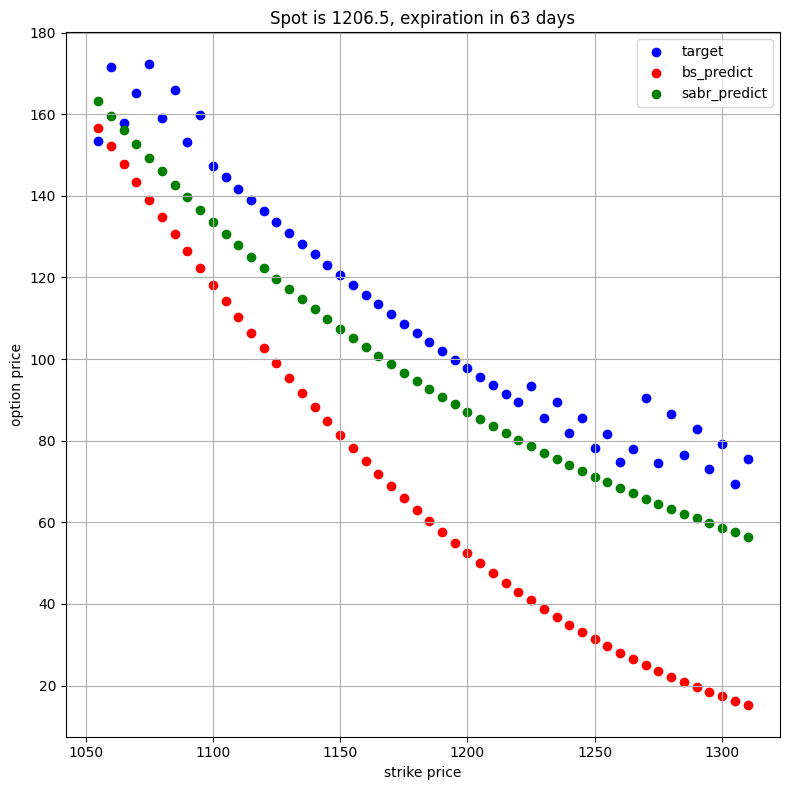

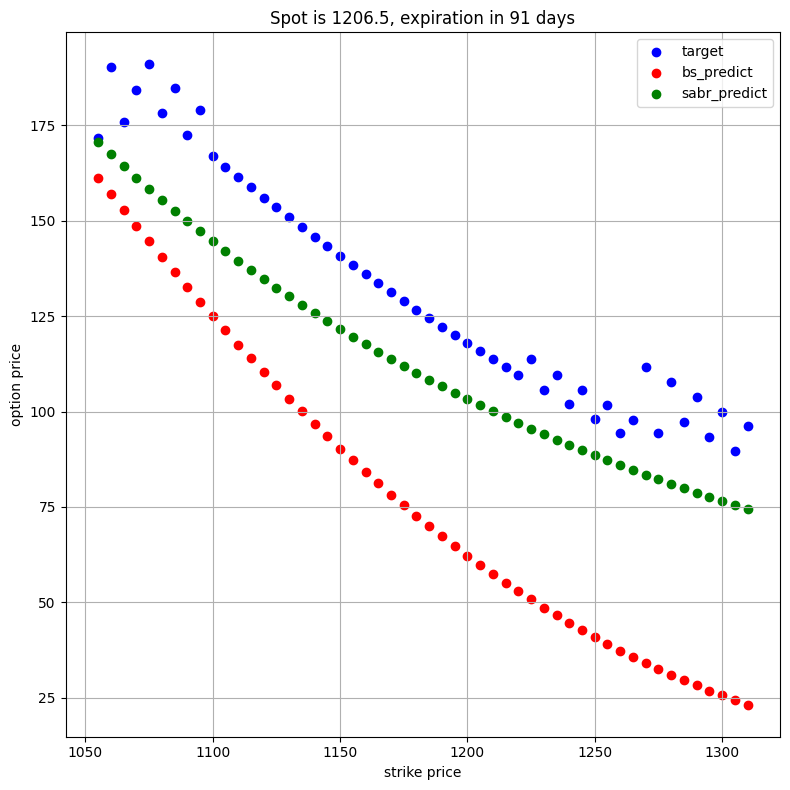

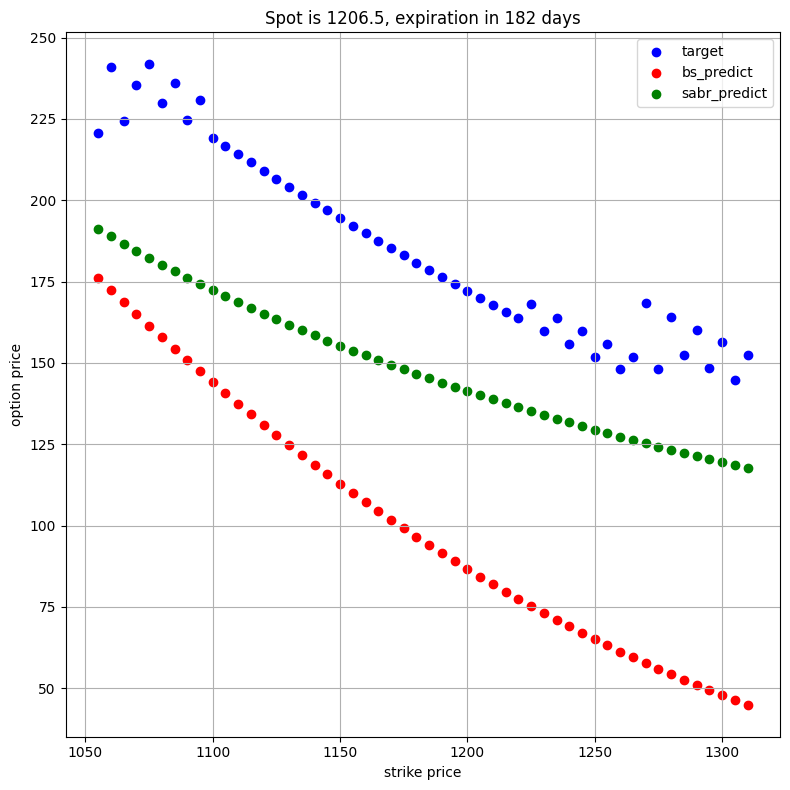

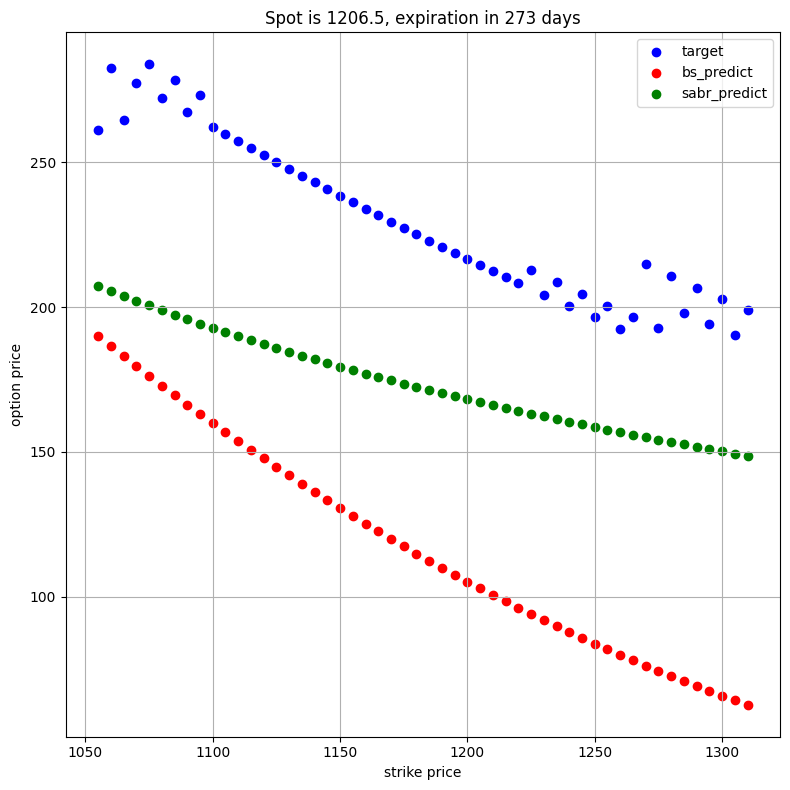

In [72]:
for date in X_test.ts.unique():
    tmp = X_test[X_test.ts == date].reset_index(drop=True)
    
    random_picker = np.random.randint(len(tmp.dt_days.unique()))
    for i, expiration in enumerate(tmp.dt_days.unique()): 
        tmp_dated = tmp[tmp.dt_days == expiration].reset_index(drop=True)

        spot = tmp_dated.spot[0]
        x = tmp_dated['strike']

        fig = plt.figure(figsize=(8, 8))

        colors = ['blue', 'red', 'green']
        for i, z_key in enumerate(['target', 'bs_predict', 'sabr_predict']):
            z = tmp_dated[z_key]
            plt.scatter(x, z, marker='o', label=z_key, color=colors[i])

        plt.xlabel('strike price')
        plt.ylabel('option price')
        plt.title(f'Spot is {tmp_dated.spot[0]}, expiration in {expiration} days')
        plt.tight_layout()
        plt.grid()
        plt.legend()

        name = str(date)[:10] + "-" + str(expiration)
        plt.savefig(f'/Users/mark/Desktop/hse/course_work/success/pngs/compare_test/true_2d/{name}.png')
        plt.show()

In [73]:
def reverse_pricing(S, r, sigma, T, K_max, K_min, N, M):

    # Mesh
    T_grid = np.linspace(start=T/N, stop=T, num=N)
    K_grid = np.linspace(start=K_min, stop=K_max, num=M)
    K_mesh, T_mesh = np.meshgrid(K_grid, T_grid)
    
    prices = black_scholes_call_price(S, K_mesh, T_mesh, r, sigma)
    
    return K_mesh, T_mesh, prices

In [74]:
spot = S[0]

In [75]:
tmp

,expiration,ts,strike,spot,dt,dt_days,dt_years,sabr_predict,target,bs_predict
0,2011-10-21,2011-09-16,1055.0,1206.5,35 days,35,0.095890,155.869184,132.20,152.851382
1,2011-10-21,2011-09-16,1060.0,1206.5,35 days,35,0.095890,151.629039,150.20,148.078100
2,2011-10-21,2011-09-16,1065.0,1206.5,35 days,35,0.095890,147.467772,137.25,143.335915
3,2011-10-21,2011-09-16,1070.0,1206.5,35 days,35,0.095890,143.387397,143.55,138.627958
4,2011-10-21,2011-09-16,1075.0,1206.5,35 days,35,0.095890,139.389584,151.00,133.957516
...,...,...,...,...,...,...,...,...,...,...
255,2012-06-15,2011-09-16,1290.0,1206.5,273 days,273,0.747945,151.762071,206.75,69.177168
256,2012-06-15,2011-09-16,1295.0,1206.5,273 days,273,0.747945,150.957177,194.15,67.509133
257,2012-06-15,2011-09-16,1300.0,1206.5,273 days,273,0.747945,150.162141,202.80,65.873967
258,2012-06-15,2011-09-16,1305.0,1206.5,273 days,273,0.747945,149.376748,190.25,64.271278


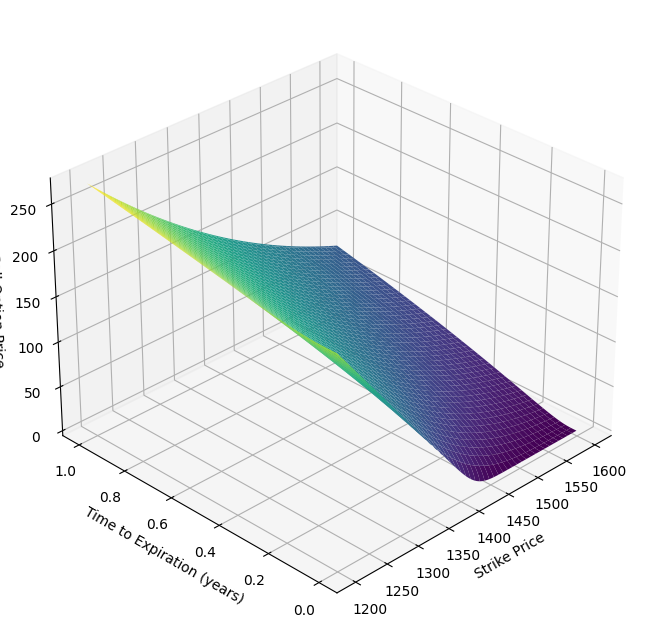

In [77]:
N, M = 364, 1000
K_mesh, T_mesh, reverse_prices = reverse_pricing(spot, r_best, sigma_best, 1, 1600, 1200, N, M)

build(K_mesh, T_mesh, reverse_prices, 'reverse', zlabel='Call Option Price', xlabel='Strike Price')